In [ ]:
import zipfile
import os

if not os.path.exists('MaskedFace.zip'):
    !wget --no-check-certificate https://empslocal.ex.ac.uk/people/staff/ad735/ECMM426/MaskedFace.zip
    !unzip -q MaskedFace.zip

# Specify a directory where the files should be extracted
extract_dir = 'MaskedFace'
os.makedirs(extract_dir, exist_ok=True)  # Create directory if it doesn't exist

# Unzip the file into the specified directory
with zipfile.ZipFile('MaskedFace.zip', 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print("✅ Dataset extracted to:", extract_dir)


--2025-03-07 22:45:22--  https://empslocal.ex.ac.uk/people/staff/ad735/ECMM426/MaskedFace.zip
Resolving empslocal.ex.ac.uk (empslocal.ex.ac.uk)... 144.173.112.51
Connecting to empslocal.ex.ac.uk (empslocal.ex.ac.uk)|144.173.112.51|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 375156724 (358M) [application/zip]
Saving to: ‘MaskedFace.zip’

MaskedFace.zip      100%[===================>] 357.78M  22.6MB/s    in 16s     

2025-03-07 22:45:39 (21.7 MB/s) - ‘MaskedFace.zip’ saved [375156724/375156724]

✅ Dataset extracted to: MaskedFace


In [ ]:
# Install ultralytics (YOLOv8)
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 922.2/922.2 kB 23.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 77.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 63.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 50.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 34.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import os
import glob
import shutil
import xml.etree.ElementTree as ET

main_dir = "/content/MaskedFace"

# set dataset paths
train_dir = os.path.join(main_dir, "train")
val_dir = os.path.join(main_dir, "val")

## YOLO directories

yolo_dir = "/content/Yolo_directory"
image_yolo_train = os.path.join(yolo_dir, "images/train")
image_yolo_val = os.path.join(yolo_dir, "images/val")
label_yolo_train = os.path.join(yolo_dir, "labels/train")
label_yolo_val = os.path.join(yolo_dir, "labels/val")

for dir_path in [image_yolo_train, image_yolo_val, label_yolo_train, label_yolo_val]:
    os.makedirs(dir_path, exist_ok=True)


In [ ]:
def convert_bbox(size, box):
    """
    Convert XML bounding box to YOLO format (normalized x_center, y_center, width, height).
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x = (int(box[0]) + int(box[2])) / 2.0
    y = (int(box[1]) + int(box[3])) / 2.0
    w = int(box[2]) - int(box[0])
    h = int(box[3]) - int(box[1])

    return f"{x * dw:.6f} {y * dh:.6f} {w * dw:.6f} {h * dh:.6f}"

# Define class mapping for YOLO (must match class indices for training)
class_map = {
    "with_mask": 0,
    "without_mask": 1,
    "mask_weared_incorrect": 2
}

def convert_annotation(xml_path, txt_output_path, image_size):
    """
    Parse XML annotation and write to YOLO format text file.
    """
    tree = ET.parse(xml_path)
    root = tree.getroot()
    with open(txt_output_path, "w") as f:
        for obj in root.findall("object"):
            class_name = obj.find("name").text
            if class_name not in class_map:
                continue  # Skip unknown classes

            bbox = [
                int(obj.find("bndbox/xmin").text),
                int(obj.find("bndbox/ymin").text),
                int(obj.find("bndbox/xmax").text),
                int(obj.find("bndbox/ymax").text)
            ]

            # Convert to YOLO format
            yolo_bbox = convert_bbox(image_size, bbox)
            f.write(f"{class_map[class_name]} {yolo_bbox}\n")


In [ ]:
from PIL import Image

def process_images(image_dir, label_dir, yolo_image_dir, yolo_label_dir):
    """
    Convert dataset images and annotations into YOLO format.
    """
    images = glob.glob(os.path.join(image_dir, "*.png"))

    for img_path in images:
        img_name = os.path.basename(img_path)
        xml_path = os.path.join(image_dir, img_name.replace(".png", ".xml"))

        # Check if annotation exists
        if not os.path.exists(xml_path):
            continue

        # Load image to get size
        with Image.open(img_path) as img:
            image_size = img.size  # (width, height)
            img.save(os.path.join(yolo_image_dir, img_name))  # Copy image

        # Convert annotation
        txt_output_path = os.path.join(yolo_label_dir, img_name.replace(".png", ".txt"))
        convert_annotation(xml_path, txt_output_path, image_size)

# Process training and validation sets
# process_images(IMAGE_DIR_TRAIN, IMAGE_DIR_TRAIN, IMAGE_DIR_YOLO_TRAIN, LABEL_DIR_YOLO_TRAIN)
# process_images(IMAGE_DIR_VAL, IMAGE_DIR_VAL, IMAGE_DIR_YOLO_VAL, LABEL_DIR_YOLO_VAL)

process_images(train_dir, train_dir, image_yolo_train, label_yolo_train)
process_images(val_dir, val_dir, image_yolo_val, label_yolo_val)




In [ ]:
dataset_yaml = """
path: /content/Yolo_directory
train: images/train
val: images/val
nc: 3
names: ['with_mask', 'without_mask', 'mask_weared_incorrect']
"""

with open("/content/masked_face.yaml", "w") as f:
    f.write(dataset_yaml)

%cat /content/masked_face.yaml



path: /content/Yolo_directory
train: images/train
val: images/val
nc: 3
names: ['with_mask', 'without_mask', 'mask_weared_incorrect']


In [ ]:
from ultralytics import YOLO
import gc
import torch

gc.collect()
torch.cuda.empty_cache()
batch_size = 16  # Default
if torch.cuda.get_device_properties(0).total_memory < 16e9:  # If GPU RAM < 16GB
    batch_size = 8  # Reduce batch size to avoid OOM

# Check if GPU is available
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

# Load YOLOv8 model (pre-trained)
model_2 = YOLO("yolov8n.pt") # Mape = 7-11% fastest
# model_2 = YOLO("yolov8m.pt") # Mape = 5-6% Balanced speed

# Train model_2 with early stopping
model_2.train(
    data="/content/masked_face.yaml",
    epochs=150,  # Max epochs
    imgsz=640,  # Image size
    batch=batch_size,
    device=device,
    patience=50,  # Stops training if validation loss doesn't improve for 50 epochs
)

print("\n✅ Training Completed (Early Stopping Applied if triggered).")


Using device: cuda
Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/masked_face.yaml, epochs=150, time=None, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_con

train: Scanning /content/Yolo_directory/labels/train.cache... 682 images, 0 backgrounds, 0 corrupt: 100%|██████████| 682/682 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/Yolo_directory/labels/val.cache... 85 images, 0 backgrounds, 0 corrupt: 100%|██████████| 85/85 [00:00<?, ?it/s]


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train4
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      3.87G      1.467      1.648      1.289         13        640: 100%|██████████| 86/86 [00:25<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.17it/s]

                   all         85        531       0.43       0.56       0.43      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      3.49G      1.269     0.9855      1.169         22        640: 100%|██████████| 86/86 [00:23<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.52it/s]

                   all         85        531      0.529      0.478      0.435      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150       3.5G      1.271       1.01      1.169          5        640: 100%|██████████| 86/86 [00:24<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.61it/s]

                   all         85        531      0.699      0.694      0.712      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      3.47G      1.259     0.8932      1.159         31        640: 100%|██████████| 86/86 [00:24<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.55it/s]

                   all         85        531      0.781      0.612      0.693      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      3.58G      1.258     0.9006      1.155         10        640: 100%|██████████| 86/86 [00:24<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.41it/s]

                   all         85        531      0.812      0.631      0.773      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150       3.5G      1.191     0.8054      1.127         18        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.782      0.695       0.76      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      3.49G      1.196      0.792      1.123          7        640: 100%|██████████| 86/86 [00:24<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.27it/s]

                   all         85        531      0.733      0.756      0.766      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      3.59G      1.183     0.7718      1.132          3        640: 100%|██████████| 86/86 [00:26<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.728      0.741      0.801      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      3.47G      1.163     0.7572      1.104         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         85        531      0.807      0.846      0.861      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      3.49G      1.162     0.7452      1.111          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.65it/s]

                   all         85        531      0.841      0.778      0.824      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      3.59G      1.129     0.7173      1.078          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         85        531       0.83      0.851      0.877      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      3.49G      1.127     0.7139      1.093          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.62it/s]

                   all         85        531      0.905      0.745      0.842      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      3.54G      1.114     0.6811      1.082         11        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.794      0.866       0.89      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      3.73G      1.096     0.6572      1.073          6        640: 100%|██████████| 86/86 [00:24<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.68it/s]


                   all         85        531       0.73      0.832      0.831      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      3.48G      1.067     0.6547      1.055         10        640: 100%|██████████| 86/86 [00:24<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.92it/s]

                   all         85        531      0.844      0.814      0.895      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      3.48G      1.078     0.6587      1.064         26        640: 100%|██████████| 86/86 [00:25<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.22it/s]

                   all         85        531       0.86      0.714      0.859        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      3.58G      1.068     0.6463      1.061         16        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.92it/s]

                   all         85        531      0.849      0.803      0.876      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      3.48G      1.072     0.6408      1.058         20        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         85        531      0.934      0.867      0.919      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      3.61G      1.065     0.6237      1.072         23        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.897      0.886      0.915      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      3.48G      1.063     0.5977      1.064         11        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531      0.883      0.815        0.9       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      3.45G      1.043     0.6201      1.065         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.56it/s]

                   all         85        531      0.851      0.855      0.903      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      3.51G       1.05     0.5964      1.043          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531      0.913      0.853        0.9      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150       3.5G      1.037     0.6057      1.047         25        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.938       0.79      0.902      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      3.49G      1.036     0.5839      1.048         50        640: 100%|██████████| 86/86 [00:25<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.65it/s]

                   all         85        531      0.899      0.832      0.901      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      3.57G      1.042     0.5797      1.037         15        640: 100%|██████████| 86/86 [00:26<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.82it/s]

                   all         85        531      0.868      0.882      0.913      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      3.55G      1.018     0.5849      1.031         24        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.78it/s]

                   all         85        531      0.828      0.801        0.9      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      3.48G      1.008     0.5616      1.028         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.31it/s]

                   all         85        531      0.919      0.842      0.913       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      3.49G      1.023     0.5756      1.036          9        640: 100%|██████████| 86/86 [00:26<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.69it/s]

                   all         85        531       0.93      0.847      0.904      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150       3.5G      1.042     0.5907      1.049         11        640: 100%|██████████| 86/86 [00:24<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.50it/s]

                   all         85        531      0.889      0.842      0.906      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      3.47G      1.008     0.5506      1.027         32        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.80it/s]

                   all         85        531      0.883      0.849      0.908      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      3.62G      1.005     0.5619      1.023          4        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531      0.899      0.879      0.895      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      3.49G     0.9917     0.5535      1.025         11        640: 100%|██████████| 86/86 [00:25<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.58it/s]

                   all         85        531      0.882       0.88      0.893      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      3.49G     0.9902     0.5362      1.022         10        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.58it/s]

                   all         85        531      0.908      0.879      0.915      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      3.61G     0.9969     0.5295      1.017         13        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         85        531      0.918      0.843      0.892       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      3.47G     0.9536     0.5139     0.9984         12        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.60it/s]

                   all         85        531      0.932      0.862      0.926      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150       3.6G     0.9875     0.5229      1.026         13        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.12it/s]

                   all         85        531      0.915      0.805      0.889      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      3.42G     0.9579     0.5166      1.013          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         85        531      0.834      0.861      0.877      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      3.66G     0.9661       0.52      1.007          2        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.55it/s]

                   all         85        531      0.883      0.871      0.908      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      3.61G     0.9607     0.5157      1.003          5        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.49it/s]

                   all         85        531      0.874      0.825      0.879      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      3.49G     0.9543     0.5145      1.008          6        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         85        531      0.845      0.848      0.889      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      3.75G     0.9513     0.5018     0.9895          9        640: 100%|██████████| 86/86 [00:26<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         85        531      0.876      0.868      0.918      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      3.49G     0.9514      0.506     0.9922         17        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         85        531      0.854      0.874      0.899      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      3.51G     0.9398     0.4993     0.9881         21        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.55it/s]

                   all         85        531      0.882      0.885      0.928       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150       3.6G       0.93     0.4934     0.9878         34        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.38it/s]

                   all         85        531      0.916       0.87      0.932      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      3.53G     0.9091     0.4882     0.9929          4        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.57it/s]

                   all         85        531      0.895       0.87      0.908      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      3.61G      0.906     0.4845     0.9955         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.936      0.873      0.942      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      3.59G     0.9425      0.489     0.9944          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.836      0.865      0.897      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150       3.6G     0.9319     0.4839     0.9841         12        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         85        531      0.854      0.902      0.923      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      3.39G     0.9054     0.4816     0.9945         17        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.22it/s]

                   all         85        531      0.932      0.841      0.921      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      3.49G     0.8979     0.4677     0.9781         11        640: 100%|██████████| 86/86 [00:25<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531      0.891      0.858      0.915      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      3.49G     0.8925     0.4676     0.9697          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.73it/s]

                   all         85        531      0.867       0.88       0.92       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      3.49G     0.8837     0.4614     0.9744          3        640: 100%|██████████| 86/86 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.04it/s]

                   all         85        531      0.906      0.916      0.946      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      3.56G     0.9054     0.4773     0.9729         26        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.43it/s]

                   all         85        531      0.952      0.857      0.934       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      3.67G     0.8842     0.4561     0.9704         17        640: 100%|██████████| 86/86 [00:25<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         85        531      0.949      0.891      0.945      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      3.62G     0.8761     0.4608     0.9716         35        640: 100%|██████████| 86/86 [00:25<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         85        531      0.916      0.862      0.932      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      3.49G     0.8612     0.4611     0.9619         17        640: 100%|██████████| 86/86 [00:24<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.92it/s]

                   all         85        531       0.84      0.917      0.927      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      3.52G     0.8843     0.4664     0.9683          5        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.99it/s]

                   all         85        531      0.883       0.92      0.935      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      3.49G       0.88     0.4517     0.9685          7        640: 100%|██████████| 86/86 [00:24<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.08it/s]

                   all         85        531      0.904      0.893      0.933      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      3.61G     0.8803     0.4581     0.9657         28        640: 100%|██████████| 86/86 [00:24<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         85        531      0.877      0.872      0.915      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      3.49G     0.8367     0.4378     0.9563          6        640: 100%|██████████| 86/86 [00:24<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.35it/s]

                   all         85        531      0.871      0.922      0.939      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      3.47G       0.86     0.4553     0.9674         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         85        531      0.913      0.915      0.935      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      3.49G     0.8462     0.4402     0.9597         12        640: 100%|██████████| 86/86 [00:24<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         85        531      0.907      0.907      0.948      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      3.61G     0.8531     0.4489     0.9508         28        640: 100%|██████████| 86/86 [00:24<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.55it/s]

                   all         85        531      0.927       0.92      0.948      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      3.49G     0.8276     0.4272     0.9506          7        640: 100%|██████████| 86/86 [00:24<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         85        531       0.85      0.885      0.902      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      3.63G     0.8279      0.434     0.9481         23        640: 100%|██████████| 86/86 [00:25<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.49it/s]

                   all         85        531      0.918      0.871      0.929      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      3.48G     0.8273     0.4357     0.9559          8        640: 100%|██████████| 86/86 [00:24<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.94it/s]

                   all         85        531       0.89      0.873      0.934      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      3.48G     0.8051      0.421     0.9543         19        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.58it/s]

                   all         85        531      0.911      0.869      0.921      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      3.57G     0.8196     0.4256     0.9552         22        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.63it/s]

                   all         85        531       0.92      0.906      0.924      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      3.52G     0.8147     0.4256     0.9456          6        640: 100%|██████████| 86/86 [00:24<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.55it/s]

                   all         85        531      0.913      0.899      0.918       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      3.49G     0.8055     0.4143     0.9422         20        640: 100%|██████████| 86/86 [00:24<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.48it/s]

                   all         85        531      0.896      0.893      0.926      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      3.62G      0.825     0.4289     0.9442         29        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.22it/s]

                   all         85        531      0.937      0.844      0.931      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      3.48G     0.7931     0.4219     0.9415         16        640: 100%|██████████| 86/86 [00:25<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.901      0.893      0.942      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      3.42G     0.8214     0.4302     0.9525          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         85        531      0.931      0.876      0.935      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      3.62G     0.8296     0.4225     0.9474         18        640: 100%|██████████| 86/86 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         85        531       0.86      0.883      0.921       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150       3.5G     0.7931     0.4124     0.9362         13        640: 100%|██████████| 86/86 [00:24<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.95it/s]

                   all         85        531      0.882      0.895      0.915      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      3.49G     0.8057     0.4222     0.9413          4        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.67it/s]

                   all         85        531      0.909      0.895      0.933      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      3.52G      0.767     0.3926      0.931         12        640: 100%|██████████| 86/86 [00:24<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.74it/s]

                   all         85        531      0.955      0.859       0.94       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      3.48G      0.777     0.3954     0.9335         11        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.69it/s]

                   all         85        531      0.834       0.93      0.923      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150       3.6G      0.772      0.394     0.9329          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.67it/s]

                   all         85        531      0.924      0.885      0.946      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150       3.6G     0.7797     0.4128     0.9361          4        640: 100%|██████████| 86/86 [00:24<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.34it/s]

                   all         85        531      0.916      0.869       0.93      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      3.61G     0.7763     0.3974     0.9256         17        640: 100%|██████████| 86/86 [00:24<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.82it/s]

                   all         85        531      0.902      0.908      0.934      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150       3.5G       0.78     0.4021     0.9253         20        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.65it/s]

                   all         85        531      0.893      0.907      0.921      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      3.49G     0.7682     0.3922     0.9289          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.875      0.889      0.921      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      3.61G     0.7813     0.4008     0.9239         15        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.63it/s]

                   all         85        531       0.87      0.907      0.942      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      3.64G     0.7594     0.3909     0.9254         19        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.21it/s]


                   all         85        531      0.876       0.88      0.924       0.66

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      3.61G     0.7467     0.3881     0.9244         13        640: 100%|██████████| 86/86 [00:24<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.88it/s]

                   all         85        531      0.919      0.874      0.937      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      3.69G     0.7332     0.3821     0.9219          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.93it/s]

                   all         85        531      0.884      0.919       0.93       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150       3.5G     0.7145      0.383     0.9217         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.68it/s]

                   all         85        531      0.885      0.914      0.941      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150       3.5G     0.7512     0.3834     0.9222          6        640: 100%|██████████| 86/86 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         85        531      0.916      0.918      0.947      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      3.63G     0.7329     0.3728     0.9143         15        640: 100%|██████████| 86/86 [00:24<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.78it/s]

                   all         85        531      0.904      0.919      0.946      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      3.54G     0.7236     0.3726     0.9117         13        640: 100%|██████████| 86/86 [00:28<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.64it/s]

                   all         85        531      0.855      0.954      0.961      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      3.49G     0.7167     0.3755     0.9177         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.57it/s]

                   all         85        531      0.828      0.932       0.93      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      3.45G      0.717     0.3711     0.9089          2        640: 100%|██████████| 86/86 [00:26<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         85        531      0.846      0.916      0.929      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      3.47G      0.712     0.3723     0.9148          3        640: 100%|██████████| 86/86 [00:28<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.89it/s]

                   all         85        531      0.877      0.875      0.928      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      3.61G     0.7102     0.3654     0.9129          4        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.37it/s]

                   all         85        531      0.857      0.906      0.943       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      3.59G     0.7073     0.3659     0.9111         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.56it/s]

                   all         85        531      0.909       0.88      0.924      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      3.59G     0.7038     0.3619     0.9026          6        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.60it/s]

                   all         85        531      0.891      0.873      0.937      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      3.48G     0.7092     0.3641     0.9094          9        640: 100%|██████████| 86/86 [00:26<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         85        531      0.906      0.907      0.952      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      3.55G     0.7105       0.36     0.9189         11        640: 100%|██████████| 86/86 [00:26<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         85        531      0.868      0.887      0.944      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      3.62G     0.6968     0.3605     0.9001         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.57it/s]

                   all         85        531      0.895      0.895      0.917      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      3.49G      0.702     0.3581     0.9081          3        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.58it/s]

                   all         85        531      0.878      0.906      0.943      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      3.71G      0.712     0.3675      0.911          3        640: 100%|██████████| 86/86 [00:25<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         85        531      0.857      0.939      0.944      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      3.61G     0.6582     0.3441     0.8924         15        640: 100%|██████████| 86/86 [00:26<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531      0.908      0.909      0.939      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      3.63G     0.6896     0.3525     0.8959          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.63it/s]

                   all         85        531      0.877      0.922      0.933      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      3.48G     0.6604     0.3465     0.8866         12        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         85        531      0.912      0.913       0.94      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150       3.6G     0.6683     0.3464     0.8953          3        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.22it/s]

                   all         85        531      0.918      0.902      0.934      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150       3.6G     0.6802     0.3529     0.8915         11        640: 100%|██████████| 86/86 [00:27<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.28it/s]

                   all         85        531      0.922      0.892      0.934      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      3.58G     0.6686     0.3497     0.8986         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         85        531      0.871      0.918      0.939      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      3.51G     0.6378     0.3335     0.8875         13        640: 100%|██████████| 86/86 [00:26<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.886      0.924       0.94      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      3.49G     0.6555     0.3386      0.885         15        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.82it/s]

                   all         85        531      0.812      0.926      0.928      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      3.49G      0.652     0.3392     0.8942          9        640: 100%|██████████| 86/86 [00:26<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         85        531      0.901      0.869      0.934      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      3.47G     0.6445     0.3318     0.8914          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         85        531      0.909      0.886      0.946       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      3.53G     0.6485     0.3354     0.8885         13        640: 100%|██████████| 86/86 [00:25<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.59it/s]

                   all         85        531      0.918      0.881      0.947      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      3.64G     0.6392     0.3353     0.8855          3        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         85        531      0.937      0.861      0.941      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      3.48G     0.6318     0.3341     0.8816         23        640: 100%|██████████| 86/86 [00:26<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.58it/s]

                   all         85        531      0.908      0.898      0.941      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      3.47G     0.6333     0.3373     0.8787         46        640: 100%|██████████| 86/86 [00:25<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.60it/s]

                   all         85        531      0.954      0.828      0.935      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      3.49G     0.6328     0.3323     0.8861         11        640: 100%|██████████| 86/86 [00:26<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.38it/s]

                   all         85        531      0.948      0.848      0.934      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      3.62G     0.6423     0.3312     0.8891         14        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.34it/s]

                   all         85        531      0.891      0.884      0.934      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150       3.6G     0.6223     0.3232     0.8835          4        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.65it/s]

                   all         85        531      0.868      0.928      0.927      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      3.65G     0.6116     0.3185     0.8772         33        640: 100%|██████████| 86/86 [00:25<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.22it/s]

                   all         85        531      0.886      0.887      0.927      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      3.52G     0.6224     0.3245     0.8858          9        640: 100%|██████████| 86/86 [00:24<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.01it/s]

                   all         85        531      0.873      0.884      0.927       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      3.49G     0.6108     0.3167     0.8835          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.70it/s]

                   all         85        531      0.878      0.908      0.937       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      3.62G     0.6115     0.3176     0.8716         11        640: 100%|██████████| 86/86 [00:25<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.75it/s]

                   all         85        531      0.897      0.916      0.935      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      3.49G      0.614     0.3189     0.8763          6        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.91it/s]

                   all         85        531      0.914      0.894      0.943      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      3.51G     0.6059     0.3107     0.8734          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.95it/s]

                   all         85        531      0.911      0.906      0.943      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      3.49G     0.5901     0.3064     0.8774         25        640: 100%|██████████| 86/86 [00:25<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.74it/s]

                   all         85        531      0.916      0.907      0.941      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150       3.5G      0.583     0.3075     0.8703         10        640: 100%|██████████| 86/86 [00:25<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.99it/s]

                   all         85        531      0.934       0.87      0.934      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      3.74G      0.585     0.3019     0.8743          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.94it/s]

                   all         85        531      0.885      0.907      0.948       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      3.56G      0.587     0.3103     0.8828         24        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.89it/s]

                   all         85        531      0.925      0.839      0.938       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      3.69G     0.5886     0.3113     0.8727         22        640: 100%|██████████| 86/86 [00:25<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         85        531      0.907       0.89      0.944      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      3.61G     0.6049     0.3088     0.8685         12        640: 100%|██████████| 86/86 [00:25<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.04it/s]

                   all         85        531      0.871      0.914      0.943      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      3.46G     0.5877     0.3032     0.8666          8        640: 100%|██████████| 86/86 [00:26<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.96it/s]

                   all         85        531      0.923      0.901      0.943      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      3.57G     0.5828     0.2982     0.8634         18        640: 100%|██████████| 86/86 [00:24<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.67it/s]

                   all         85        531      0.917      0.886       0.94      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      3.66G     0.5586     0.2921     0.8599          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         85        531        0.9      0.905       0.94      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      3.74G     0.5758     0.2974     0.8699          7        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.96it/s]

                   all         85        531      0.857      0.922      0.934      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      3.66G     0.5647     0.2922     0.8601          4        640: 100%|██████████| 86/86 [00:24<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.33it/s]

                   all         85        531      0.888      0.876      0.937      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      3.41G     0.5649     0.2998     0.8641          5        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.34it/s]

                   all         85        531      0.891      0.923      0.942      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      3.52G      0.555     0.2971     0.8663          8        640: 100%|██████████| 86/86 [00:25<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         85        531       0.92      0.912      0.942      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      3.61G     0.5576     0.2913     0.8616          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.78it/s]

                   all         85        531      0.891      0.931      0.941      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150       3.5G     0.5694     0.2925     0.8579         22        640: 100%|██████████| 86/86 [00:25<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.69it/s]

                   all         85        531       0.92      0.928      0.939      0.676


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      3.56G     0.5465     0.2619     0.8519          9        640: 100%|██████████| 86/86 [00:25<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.99it/s]

                   all         85        531      0.939      0.823      0.933      0.671
EarlyStopping: Training stopped early as no improvement observed in last 50 epochs. Best results observed at epoch 91, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



141 epochs completed in 1.199 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 52.0MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,841,497 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.60it/s]


                   all         85        531      0.855      0.954      0.961      0.688
             with_mask         77        436      0.903      0.954       0.97      0.698
          without_mask         27         80      0.854      0.975      0.957      0.637
 mask_weared_incorrect         11         15      0.809      0.933      0.957      0.727
Speed: 0.4ms preprocess, 11.8ms inference, 0.0ms loss, 6.9ms postprocess per image
Results saved to runs/detect/train4

✅ Training Completed (Early Stopping Applied if triggered).


In [ ]:
import os
import torch

# Ensure the directory exists
os.makedirs("data", exist_ok=True)

# Save the trained model
model_2_path = "data/weights_counting.pth"
torch.save(model_2.state_dict(), model_2_path)
print(f"✅ Model saved at: {model_2_path}")

import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

from google.colab import drive
drive.mount('/content/drive')

# Save the ZIP file to your Google Drive
!zip -r /content/drive/MyDrive/colab_backup.zip /content/


Streaming output truncated to the last 5000 lines.
updating: content/train/mask-096.xml (deflated 80%)
updating: content/train/mask-484.png (deflated 0%)
updating: content/train/mask-575.xml (deflated 83%)
updating: content/train/mask-851.png (deflated 0%)
updating: content/train/mask-216.png (deflated 0%)
updating: content/train/mask-601.png (deflated 0%)
updating: content/train/mask-178.png (deflated 0%)
updating: content/train/mask-622.xml (deflated 83%)
updating: content/train/mask-349.xml (deflated 77%)
updating: content/train/mask-477.xml (deflated 90%)
updating: content/train/mask-526.png (deflated 0%)
updating: content/train/mask-841.xml (deflated 57%)
updating: content/train/mask-306.xml (deflated 57%)
updating: content/train/mask-012.png (deflated 0%)
updating: content/train/mask-573.png (deflated 0%)
updating: content/train/mask-162.xml (deflated 56%)
updating: content/train/mask-752.xml (deflated 90%)
updating: content/train/mask-165.xml (deflated 70%)
updating: content/tra

In [ ]:
import os
import xml.etree.ElementTree as ET

# Paths to annotation directories
xml_dir = "/content/MaskedFace/val"  # Change to the correct path
yolo_labels_dir = "/content/Yolo_directory/labels/val"  # YOLO expects labels here

# Create labels directory if not exists
os.makedirs(yolo_labels_dir, exist_ok=True)

# Class names (ensure these match the dataset)
class_names = ["with_mask", "without_mask", "mask_weared_incorrect"]

# Function to convert Pascal VOC XML to YOLO format
def convert_xml_to_yolo(xml_file, txt_file):
    tree = ET.parse(xml_file)
    root = tree.getroot()

    img_width = int(root.find("size/width").text)
    img_height = int(root.find("size/height").text)

    with open(txt_file, "w") as f:
        for obj in root.findall("object"):
            class_name = obj.find("name").text
            if class_name not in class_names:
                continue  # Skip unknown classes

            class_idx = class_names.index(class_name)

            # Get bounding box coordinates
            bbox = obj.find("bndbox")
            xmin = int(bbox.find("xmin").text)
            ymin = int(bbox.find("ymin").text)
            xmax = int(bbox.find("xmax").text)
            ymax = int(bbox.find("ymax").text)

            # Convert to YOLO format (x_center, y_center, width, height normalized)
            x_center = (xmin + xmax) / (2 * img_width)
            y_center = (ymin + ymax) / (2 * img_height)
            width = (xmax - xmin) / img_width
            height = (ymax - ymin) / img_height

            # Write to YOLO format
            f.write(f"{class_idx} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

# Convert all XML annotations
for xml_file in os.listdir(xml_dir):
    if xml_file.endswith(".xml"):
        txt_file = os.path.join(yolo_labels_dir, xml_file.replace(".xml", ".txt"))
        convert_xml_to_yolo(os.path.join(xml_dir, xml_file), txt_file)

In [ ]:
import torch
import os
import numpy as np
from ultralytics import YOLO

# Load trained YOLOv8 model
model_2 = YOLO("runs/detect/train4/weights/best.pt")  # Update if needed

# Class names
class_names = ["with_mask", "without_mask", "mask_weared_incorrect"]

def count_masks(image_dir, label_dir):
    """
    Function to count mask classes and compute MAPE.

    Parameters:
    - image_dir (str): Path to validation images.
    - label_dir (str): Path to validation labels.

    Returns:
    - class_counts (np.ndarray): 2D array (num_images, 3) of class counts.
    - mape_per_image (list): List of MAPE values per image.
    - final_mape (float): Average MAPE across all images.
    """
    total_mape = []
    image_counts = []

    # Iterate over validation images
    for image_file in os.listdir(image_dir):
        if not image_file.endswith((".jpg", ".png")):
            continue  # Skip non-image files

        image_path = os.path.join(image_dir, image_file)
        label_path = os.path.join(label_dir, image_file.replace(".jpg", ".txt").replace(".png", ".txt"))

        # Load ground truth labels
        actual_counts = np.zeros(len(class_names), dtype=int)
        if os.path.exists(label_path):
            with open(label_path, "r") as f:
                for line in f:
                    class_idx = int(line.split()[0])  # Get class index
                    actual_counts[class_idx] += 1  # Count instances

        # Run inference
        results = model_2(image_path, conf=0.5)
        detected_counts = np.zeros(len(class_names), dtype=int)

        # Count predictions
        for r in results:
            for box in r.boxes:
                class_idx = int(box.cls.item())
                detected_counts[class_idx] += 1

        # Store class counts per image
        image_counts.append(detected_counts)

        # Compute MAPE per image
        mape_values = np.abs(actual_counts - detected_counts) / np.maximum(actual_counts, 1) * 100
        mape = np.mean(mape_values)
        total_mape.append(mape)

        # Print per-image MAPE
        print(f"Image: {image_file} | Actual: {actual_counts.tolist()} | Predicted: {detected_counts.tolist()} | MAPE: {mape:.2f}%")

    # Convert to 2D NumPy array
    class_counts = np.array(image_counts, dtype=np.int64)

    # Compute final average MAPE
    final_mape = np.mean(total_mape)
    # print(f"\n✅ Final Average MAPE on Validation Set: {final_mape:.2f}%")

    return class_counts, total_mape, final_mape

# Define dataset paths
image_dir = "/content/val"
label_dir = "/content/Yolo_directory/labels/val"

# Run function
class_counts, mape_per_image, average_mape = count_masks(image_dir, label_dir)

# Output results
print("\nClass counts per image:\n", class_counts)

print("\nFinal Average MAPE:", average_mape)



image 1/1 /content/val/mask-280.png: 448x640 13 with_masks, 4 without_masks, 28.3ms
Speed: 2.3ms preprocess, 28.3ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Image: mask-280.png | Actual: [15, 5, 1] | Predicted: [13, 4, 0] | MAPE: 44.44%

image 1/1 /content/val/mask-410.png: 448x640 20 with_masks, 1 mask_weared_incorrect, 27.4ms
Speed: 1.9ms preprocess, 27.4ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Image: mask-410.png | Actual: [20, 0, 1] | Predicted: [20, 0, 1] | MAPE: 0.00%

image 1/1 /content/val/mask-197.png: 384x640 1 with_mask, 26.1ms
Speed: 1.7ms preprocess, 26.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Image: mask-197.png | Actual: [1, 0, 0] | Predicted: [1, 0, 0] | MAPE: 0.00%

image 1/1 /content/val/mask-058.png: 448x640 13 with_masks, 28.1ms
Speed: 1.8ms preprocess, 28.1ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Image: mask-058.png | Actual: [13, 0, 0] | Predicted: [13, 0, 0]


image 1/1 /content/MaskedFace/val/mask-280.png: 448x640 14 with_masks, 5 without_masks, 28.3ms
Speed: 2.1ms preprocess, 28.3ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


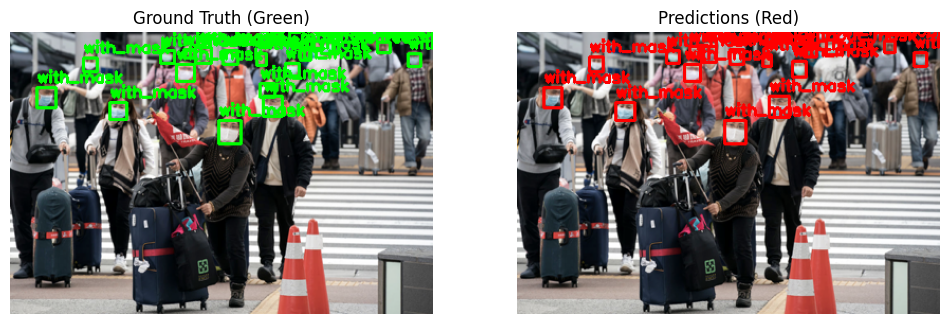


image 1/1 /content/MaskedFace/val/mask-410.png: 448x640 23 with_masks, 1 mask_weared_incorrect, 27.4ms
Speed: 4.8ms preprocess, 27.4ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


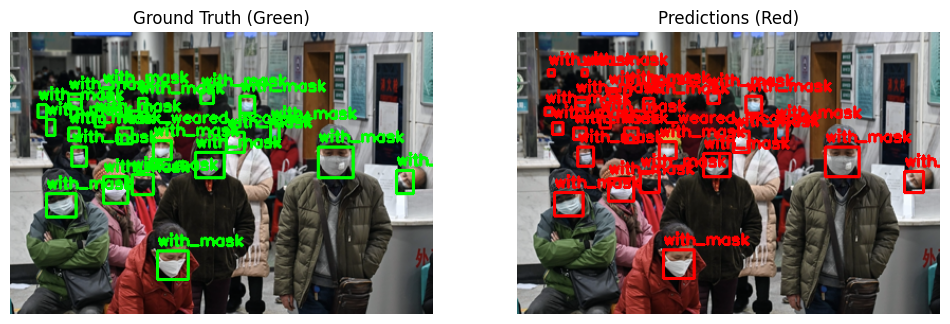


image 1/1 /content/MaskedFace/val/mask-197.png: 384x640 1 with_mask, 26.5ms
Speed: 2.7ms preprocess, 26.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


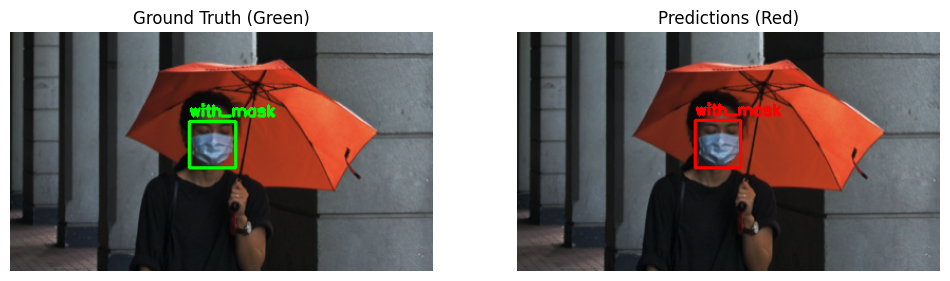


image 1/1 /content/MaskedFace/val/mask-058.png: 448x640 14 with_masks, 28.4ms
Speed: 3.1ms preprocess, 28.4ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


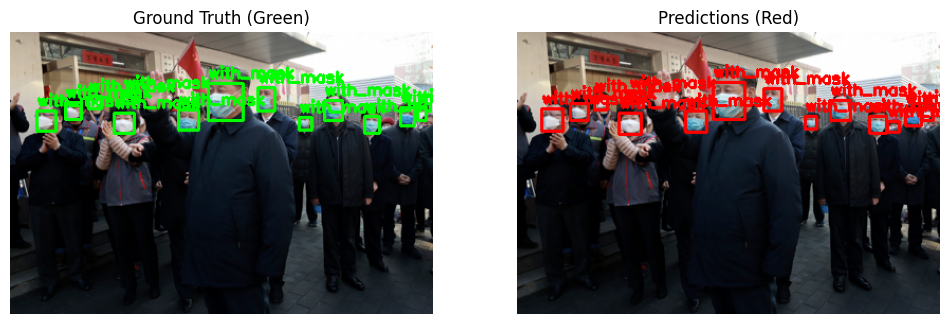


image 1/1 /content/MaskedFace/val/mask-275.png: 640x544 1 with_mask, 36.8ms
Speed: 4.3ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 544)


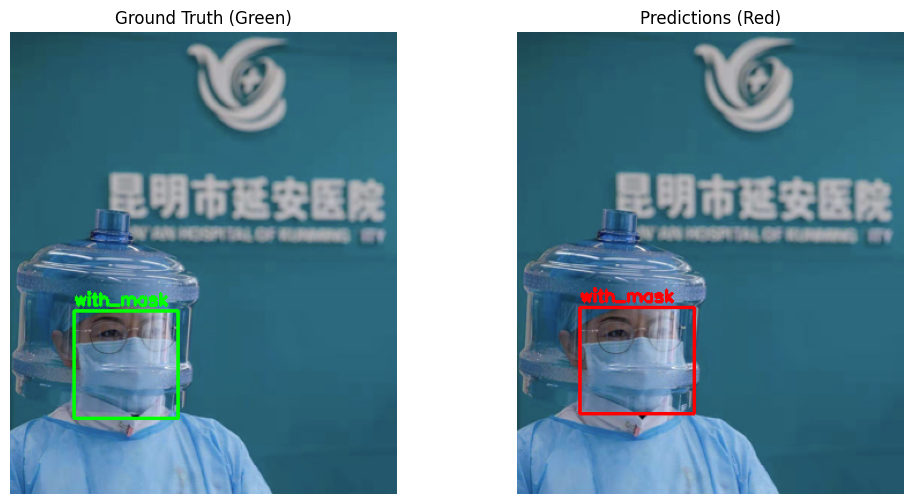


image 1/1 /content/MaskedFace/val/mask-660.png: 640x512 1 without_mask, 31.7ms
Speed: 3.8ms preprocess, 31.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 512)


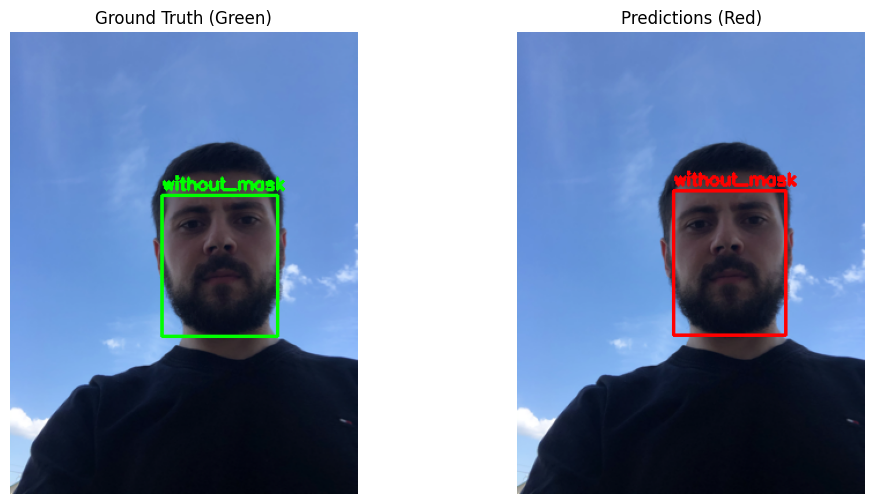


image 1/1 /content/MaskedFace/val/mask-149.png: 480x640 6 with_masks, 1 without_mask, 29.2ms
Speed: 3.3ms preprocess, 29.2ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)


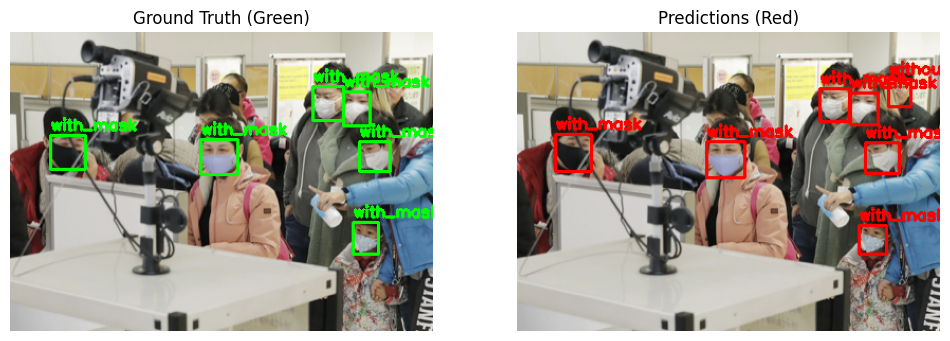


image 1/1 /content/MaskedFace/val/mask-209.png: 352x640 2 with_masks, 12 without_masks, 26.2ms
Speed: 2.7ms preprocess, 26.2ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)


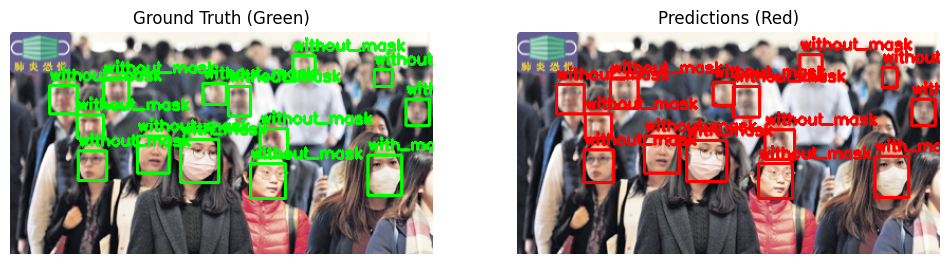


image 1/1 /content/MaskedFace/val/mask-796.png: 448x640 17 with_masks, 28.7ms
Speed: 3.2ms preprocess, 28.7ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


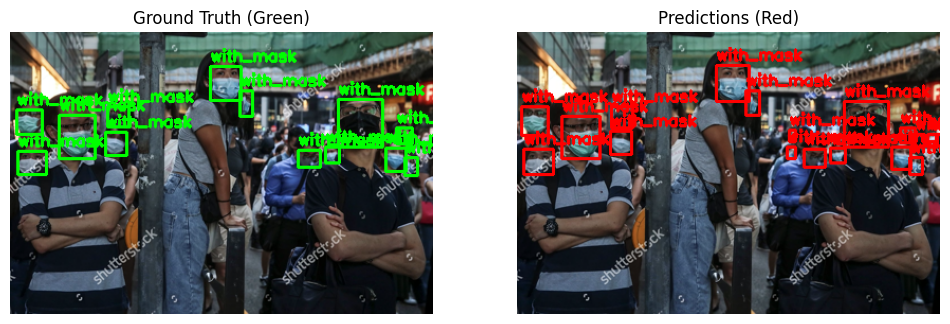


image 1/1 /content/MaskedFace/val/mask-515.png: 640x512 1 with_mask, 29.5ms
Speed: 3.4ms preprocess, 29.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 512)


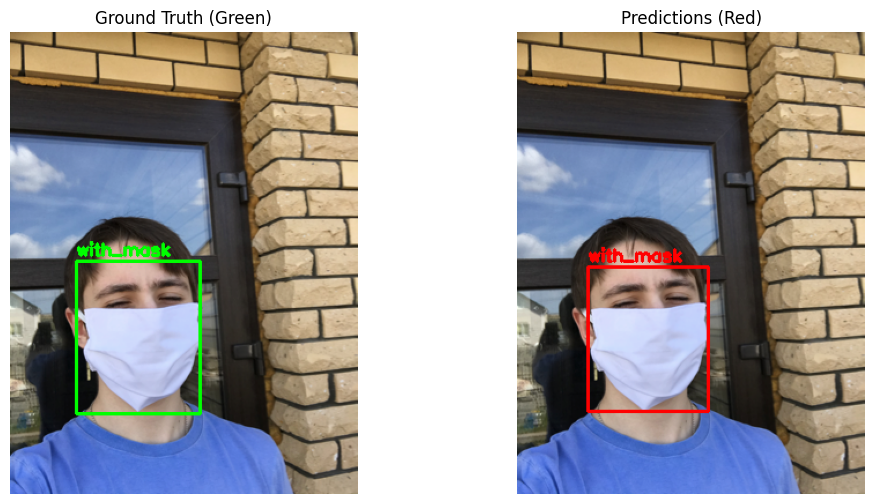


image 1/1 /content/MaskedFace/val/mask-152.png: 480x640 7 with_masks, 29.2ms
Speed: 3.6ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


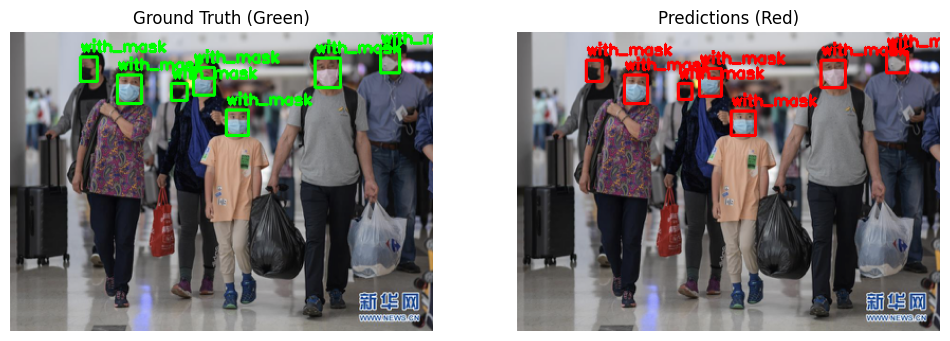


image 1/1 /content/MaskedFace/val/mask-377.png: 480x640 1 with_mask, 28.1ms
Speed: 3.5ms preprocess, 28.1ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


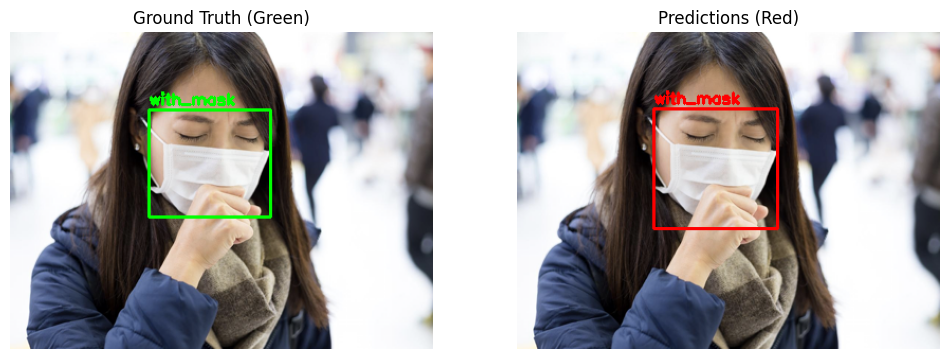


image 1/1 /content/MaskedFace/val/mask-555.png: 384x640 4 with_masks, 26.4ms
Speed: 3.4ms preprocess, 26.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


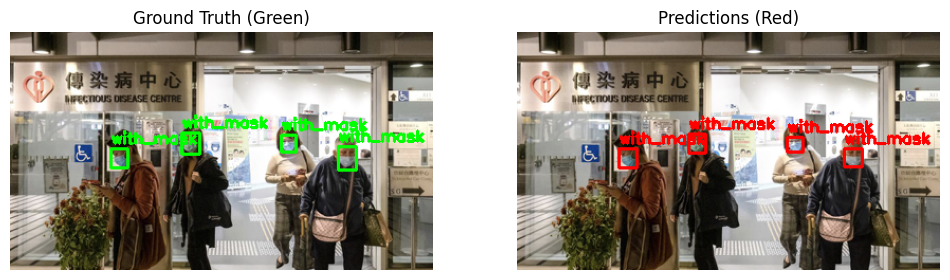


image 1/1 /content/MaskedFace/val/mask-461.png: 448x640 8 with_masks, 28.5ms
Speed: 3.2ms preprocess, 28.5ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


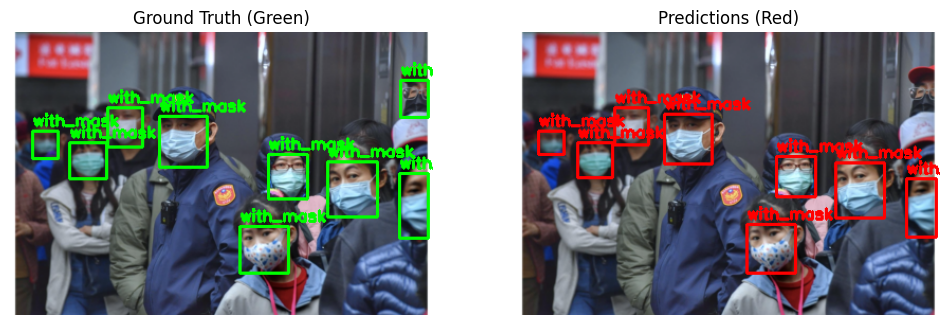


image 1/1 /content/MaskedFace/val/mask-123.png: 512x640 2 with_masks, 29.5ms
Speed: 3.6ms preprocess, 29.5ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


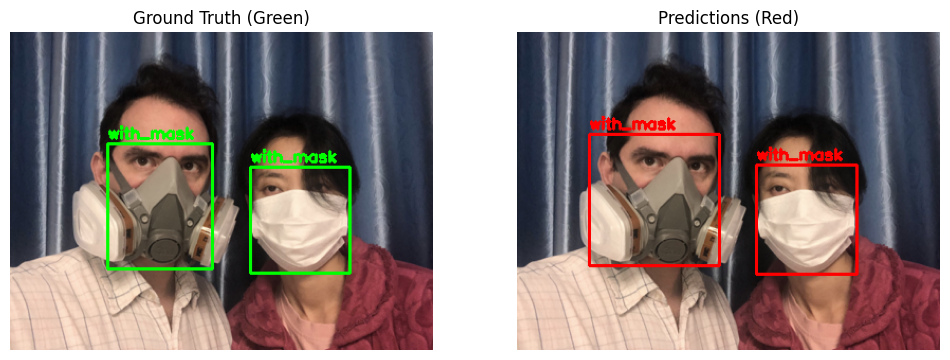


image 1/1 /content/MaskedFace/val/mask-370.png: 640x512 1 without_mask, 29.5ms
Speed: 3.6ms preprocess, 29.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)


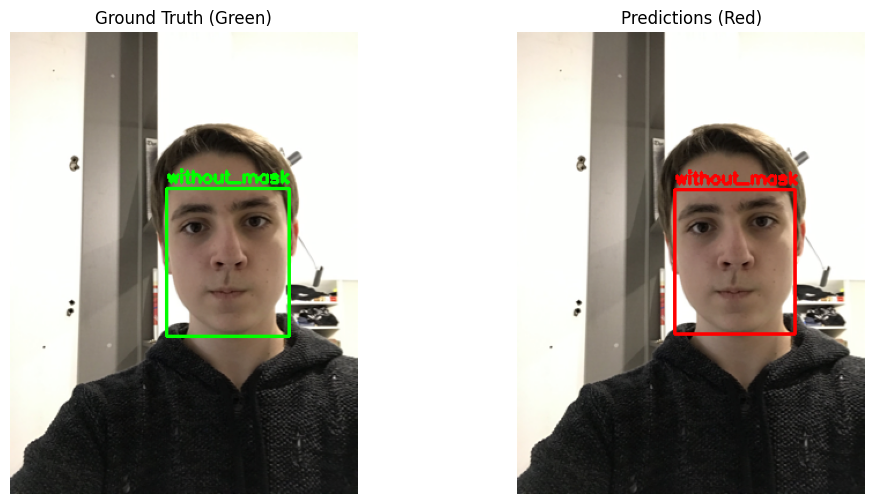


image 1/1 /content/MaskedFace/val/mask-742.png: 640x512 1 with_mask, 28.4ms
Speed: 4.8ms preprocess, 28.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 512)


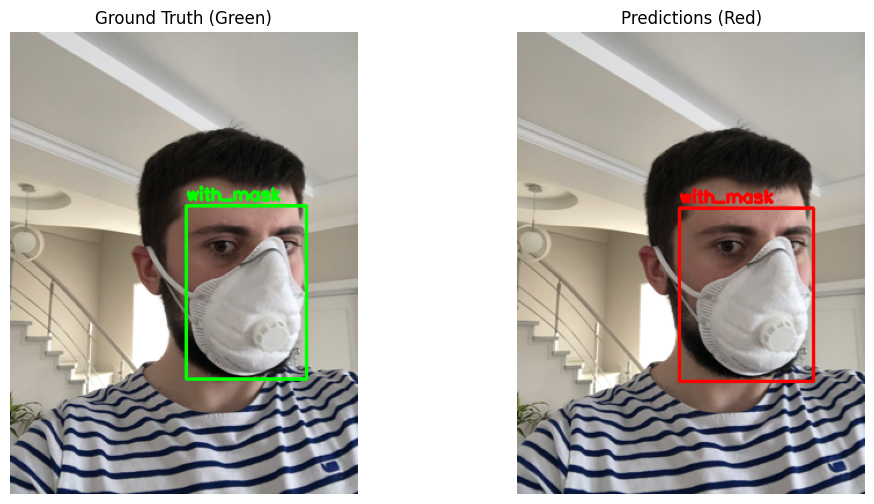


image 1/1 /content/MaskedFace/val/mask-383.png: 640x512 1 with_mask, 28.3ms
Speed: 3.5ms preprocess, 28.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)


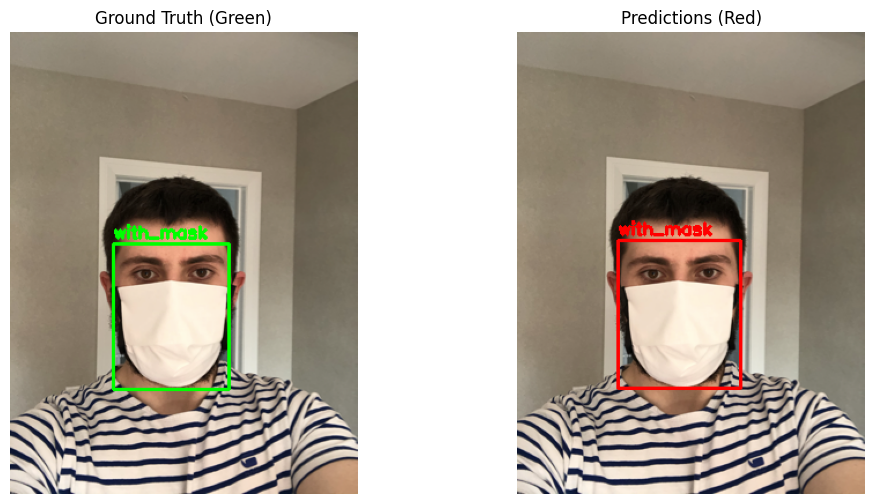


image 1/1 /content/MaskedFace/val/mask-098.png: 448x640 3 with_masks, 29.7ms
Speed: 3.0ms preprocess, 29.7ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


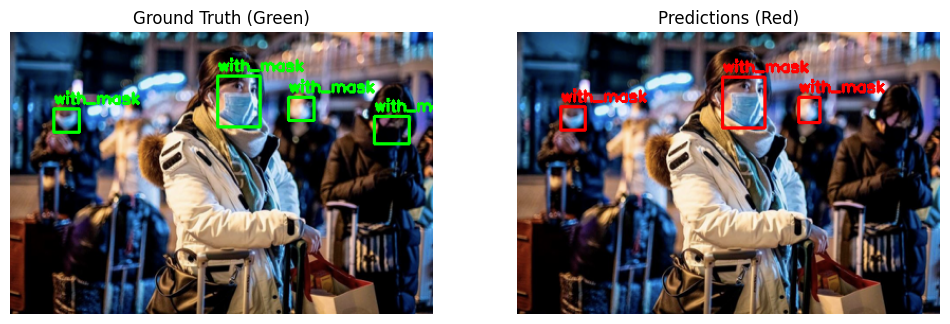


image 1/1 /content/MaskedFace/val/mask-248.png: 640x512 1 without_mask, 29.5ms
Speed: 3.5ms preprocess, 29.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)


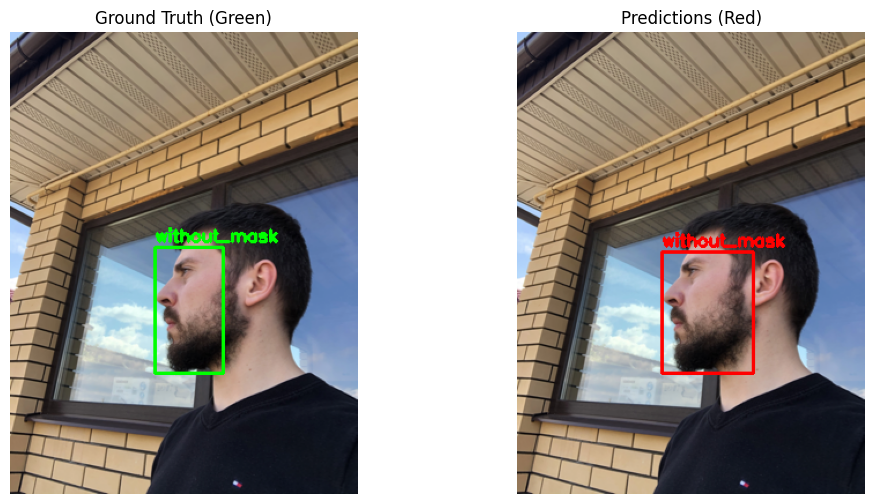


image 1/1 /content/MaskedFace/val/mask-143.png: 640x512 1 with_mask, 28.3ms
Speed: 3.5ms preprocess, 28.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)


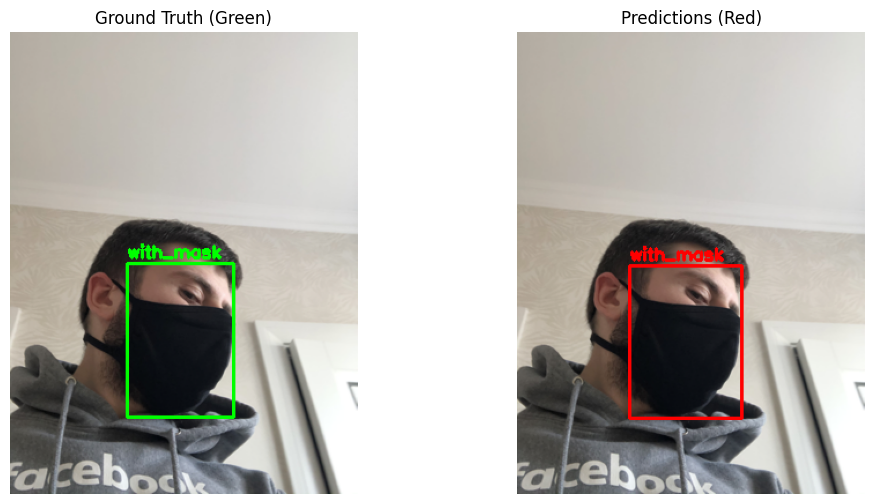


image 1/1 /content/MaskedFace/val/mask-699.png: 448x640 1 with_mask, 6 without_masks, 28.9ms
Speed: 5.2ms preprocess, 28.9ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


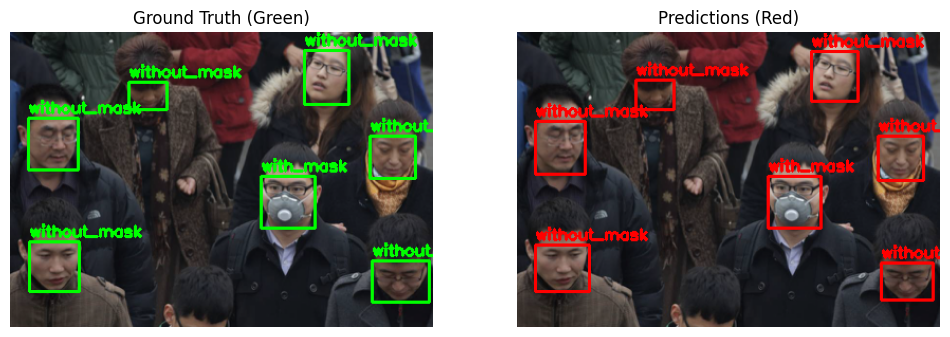


image 1/1 /content/MaskedFace/val/mask-226.png: 384x640 1 with_mask, 26.3ms
Speed: 2.8ms preprocess, 26.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


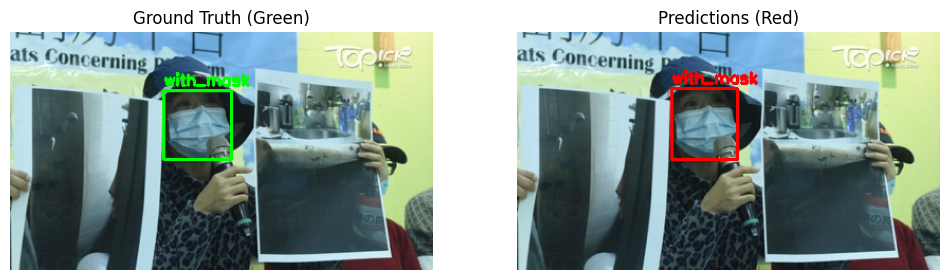


image 1/1 /content/MaskedFace/val/mask-323.png: 608x640 1 with_mask, 37.8ms
Speed: 4.2ms preprocess, 37.8ms inference, 1.7ms postprocess per image at shape (1, 3, 608, 640)


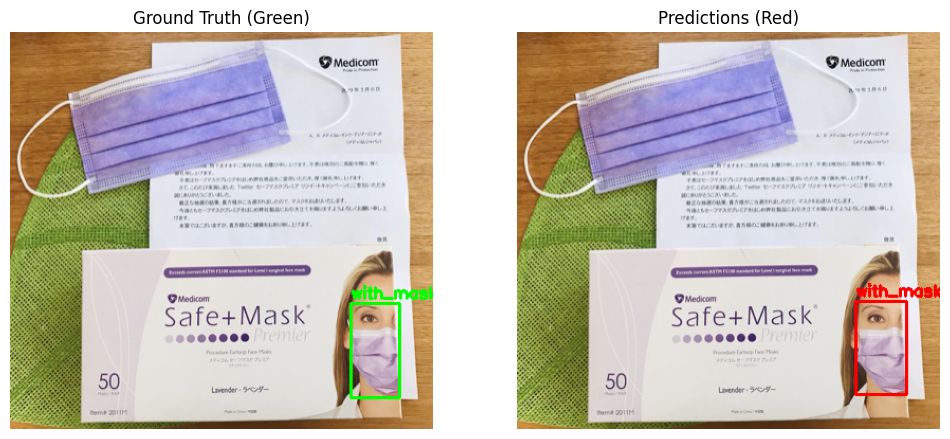


image 1/1 /content/MaskedFace/val/mask-606.png: 448x640 2 with_masks, 28.6ms
Speed: 3.1ms preprocess, 28.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


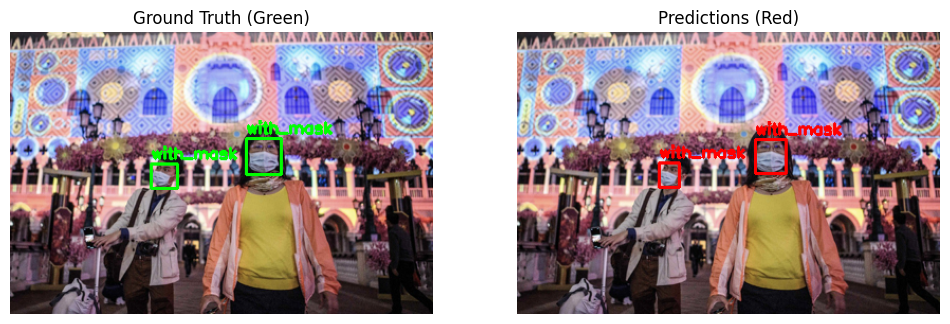


image 1/1 /content/MaskedFace/val/mask-032.png: 384x640 2 with_masks, 29.5ms
Speed: 2.7ms preprocess, 29.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


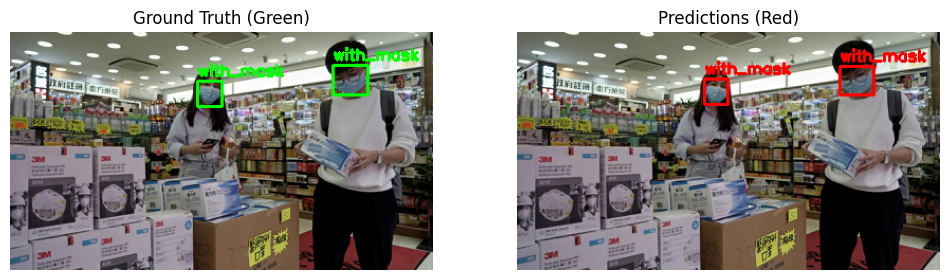


image 1/1 /content/MaskedFace/val/mask-043.png: 640x448 3 with_masks, 29.1ms
Speed: 6.3ms preprocess, 29.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 448)


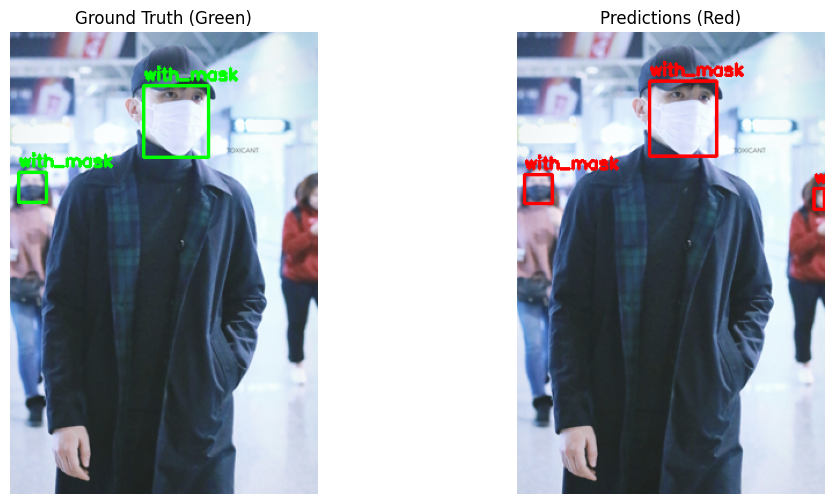


image 1/1 /content/MaskedFace/val/mask-450.png: 480x640 4 with_masks, 89.1ms
Speed: 13.4ms preprocess, 89.1ms inference, 9.3ms postprocess per image at shape (1, 3, 480, 640)


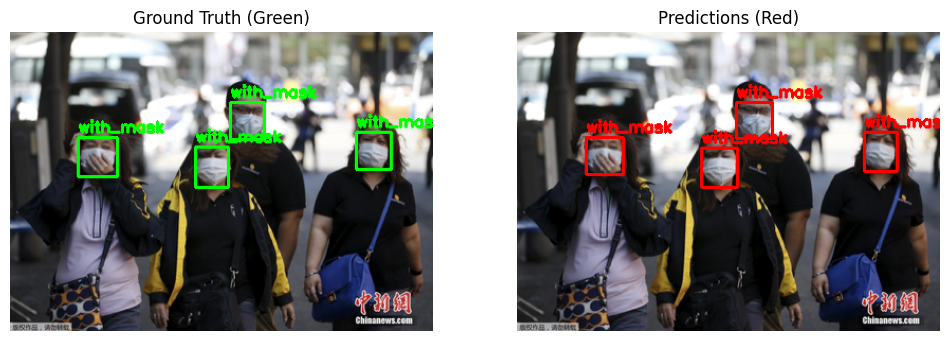


image 1/1 /content/MaskedFace/val/mask-086.png: 480x640 2 with_masks, 2 without_masks, 28.1ms
Speed: 7.8ms preprocess, 28.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


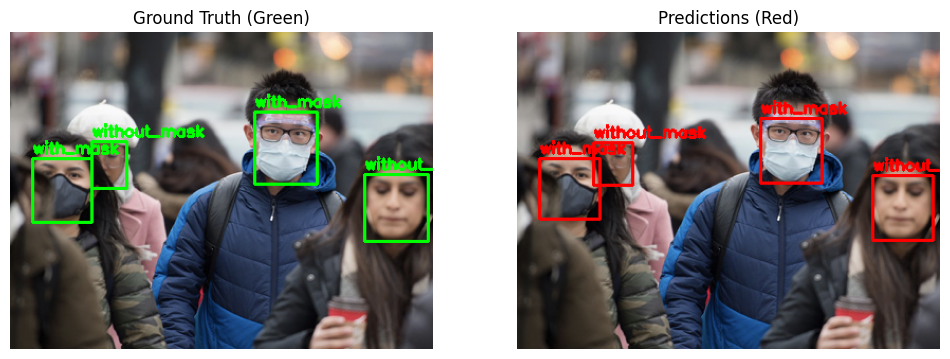


image 1/1 /content/MaskedFace/val/mask-130.png: 640x544 3 without_masks, 1 mask_weared_incorrect, 37.0ms
Speed: 7.1ms preprocess, 37.0ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 544)


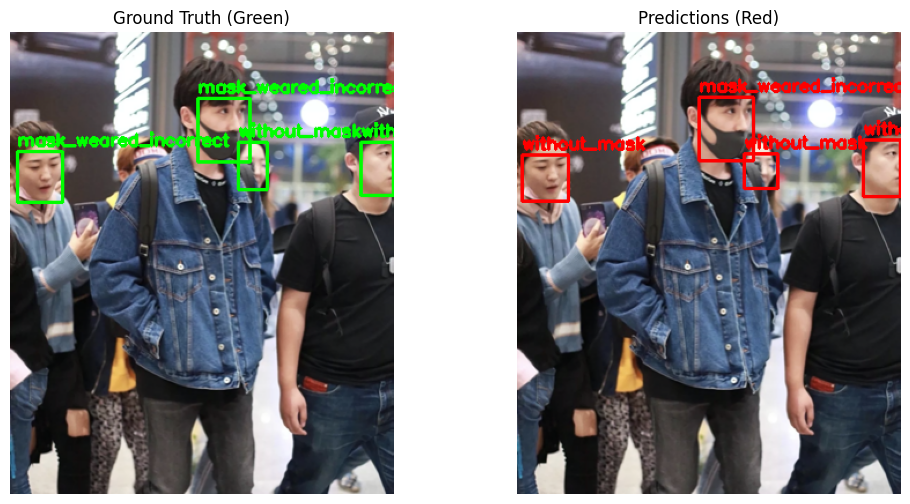


image 1/1 /content/MaskedFace/val/mask-411.png: 448x640 8 with_masks, 1 without_mask, 28.6ms
Speed: 3.2ms preprocess, 28.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


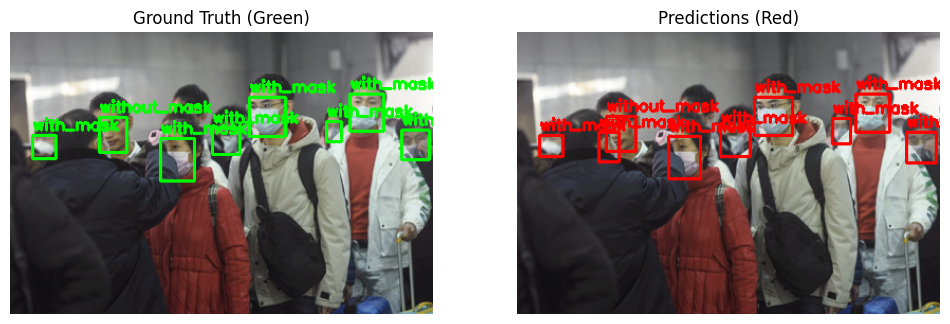


image 1/1 /content/MaskedFace/val/mask-793.png: 640x512 1 with_mask, 29.3ms
Speed: 3.3ms preprocess, 29.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)


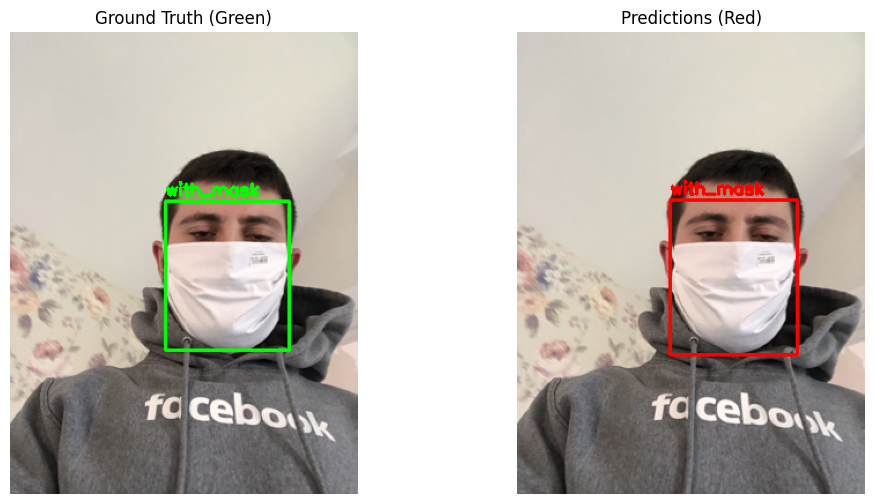


image 1/1 /content/MaskedFace/val/mask-444.png: 416x640 3 with_masks, 1 without_mask, 34.6ms
Speed: 3.0ms preprocess, 34.6ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


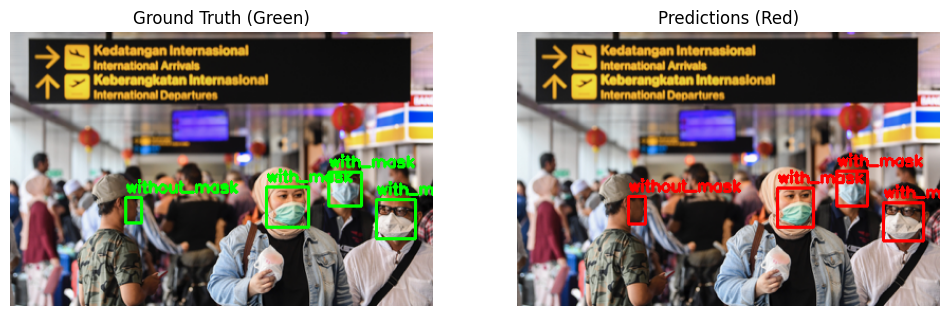


image 1/1 /content/MaskedFace/val/mask-589.png: 640x448 1 with_mask, 28.5ms
Speed: 6.2ms preprocess, 28.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 448)


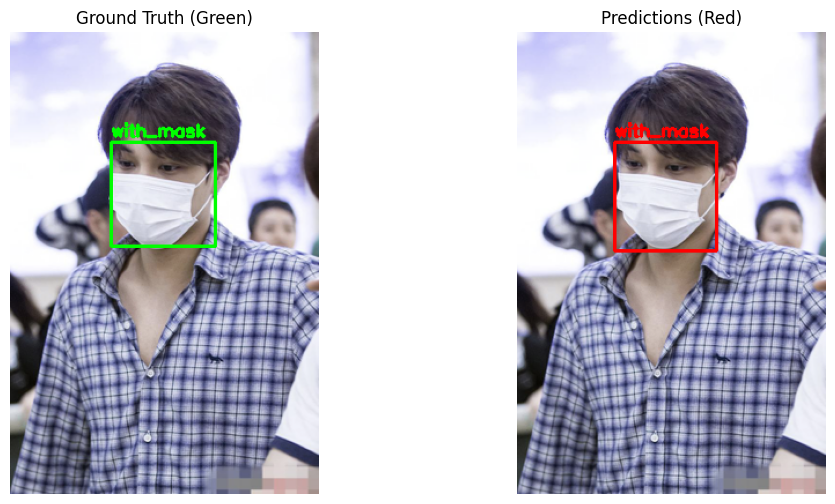


image 1/1 /content/MaskedFace/val/mask-307.png: 384x640 1 with_mask, 1 without_mask, 1 mask_weared_incorrect, 28.4ms
Speed: 2.7ms preprocess, 28.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


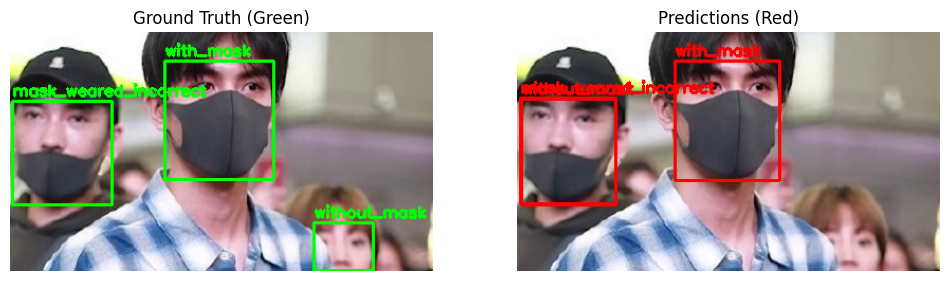


image 1/1 /content/MaskedFace/val/mask-574.png: 384x640 6 with_masks, 25.3ms
Speed: 2.7ms preprocess, 25.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


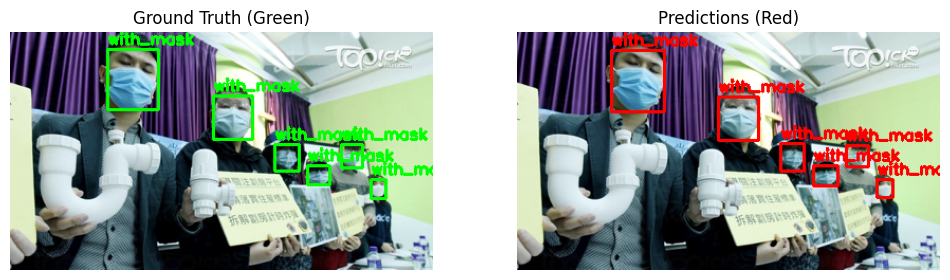


image 1/1 /content/MaskedFace/val/mask-690.png: 416x640 18 with_masks, 1 without_mask, 29.0ms
Speed: 7.5ms preprocess, 29.0ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


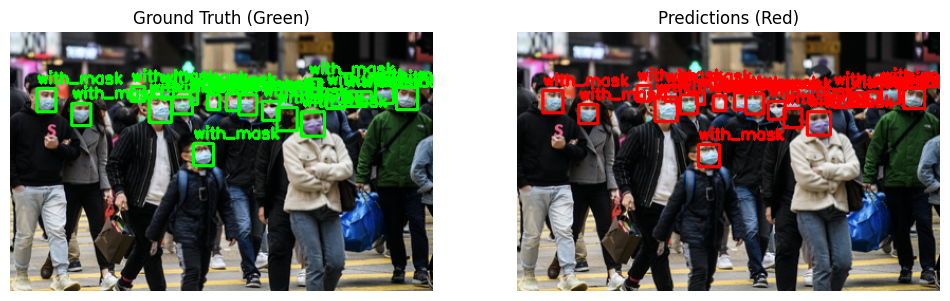


image 1/1 /content/MaskedFace/val/mask-131.png: 448x640 4 with_masks, 3 without_masks, 31.5ms
Speed: 3.1ms preprocess, 31.5ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


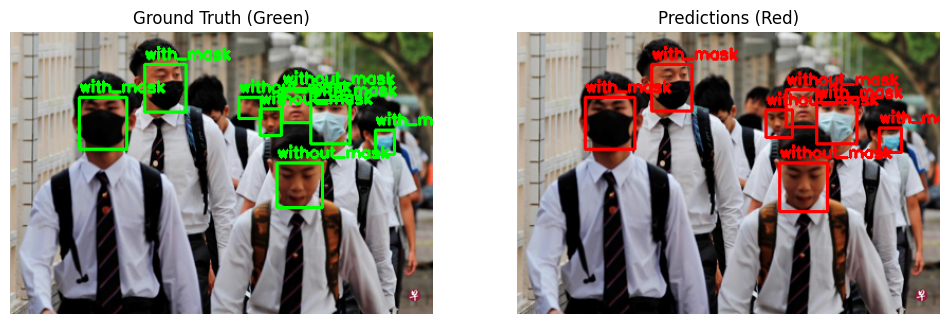


image 1/1 /content/MaskedFace/val/mask-080.png: 384x640 1 with_mask, 27.1ms
Speed: 3.5ms preprocess, 27.1ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)


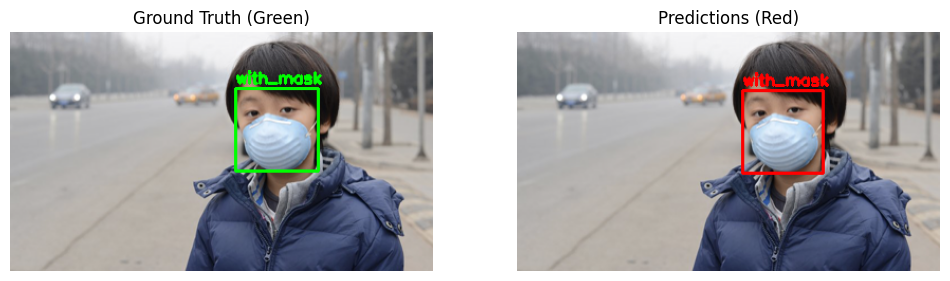


image 1/1 /content/MaskedFace/val/mask-387.png: 384x640 3 with_masks, 1 without_mask, 1 mask_weared_incorrect, 35.4ms
Speed: 3.2ms preprocess, 35.4ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


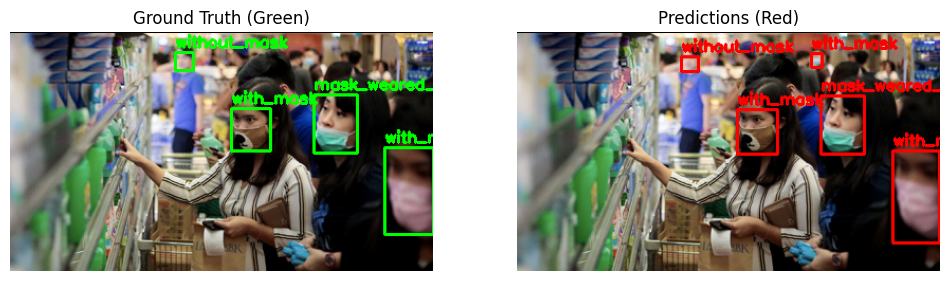


image 1/1 /content/MaskedFace/val/mask-292.png: 480x640 (no detections), 29.7ms
Speed: 3.4ms preprocess, 29.7ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


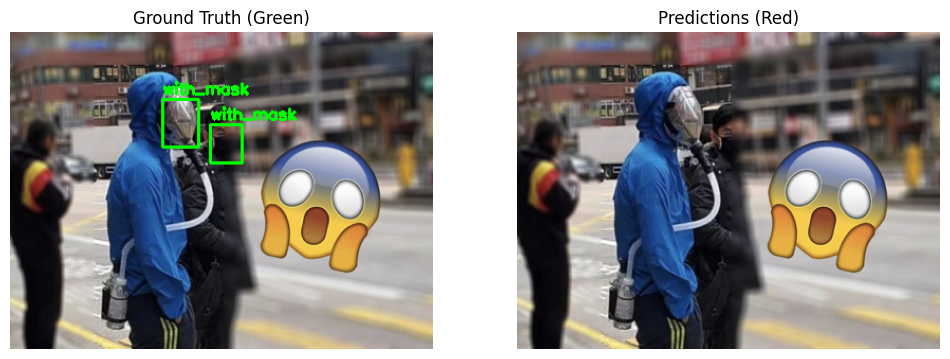


image 1/1 /content/MaskedFace/val/mask-802.png: 448x640 4 with_masks, 28.5ms
Speed: 3.3ms preprocess, 28.5ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


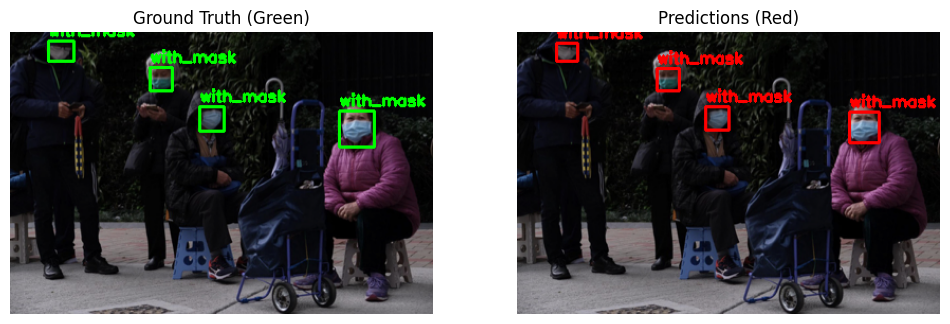


image 1/1 /content/MaskedFace/val/mask-260.png: 480x640 55 with_masks, 29.3ms
Speed: 3.6ms preprocess, 29.3ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


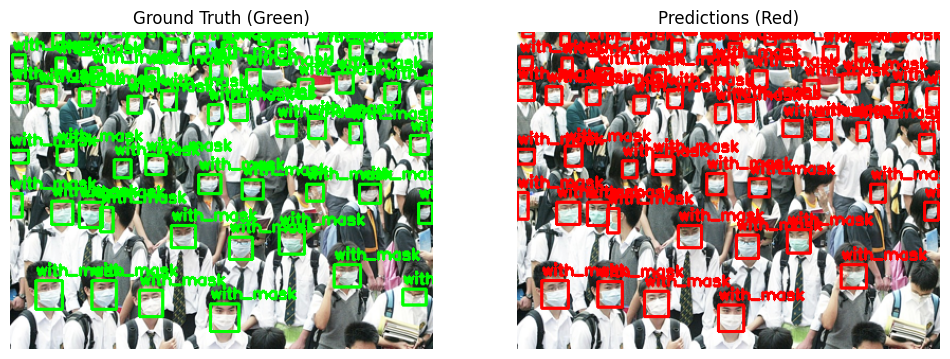


image 1/1 /content/MaskedFace/val/mask-562.png: 352x640 1 mask_weared_incorrect, 26.3ms
Speed: 2.7ms preprocess, 26.3ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)


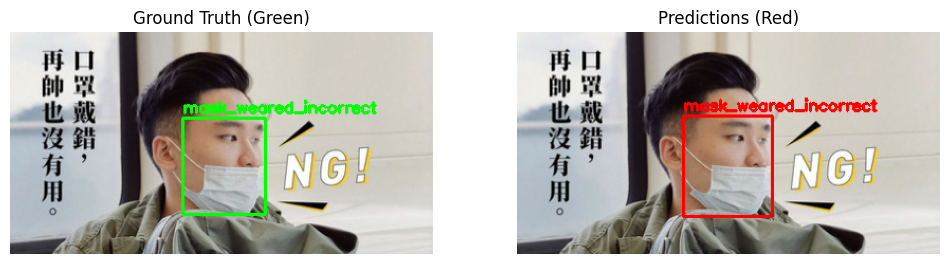


image 1/1 /content/MaskedFace/val/mask-011.png: 448x640 21 with_masks, 1 mask_weared_incorrect, 28.8ms
Speed: 5.2ms preprocess, 28.8ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


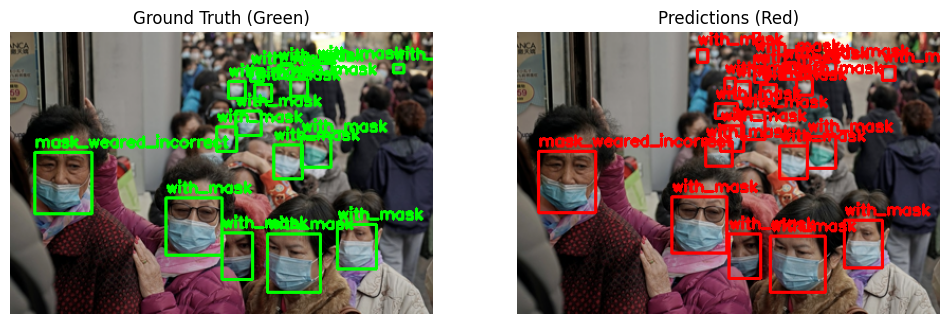


image 1/1 /content/MaskedFace/val/mask-286.png: 480x640 2 with_masks, 29.2ms
Speed: 3.5ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


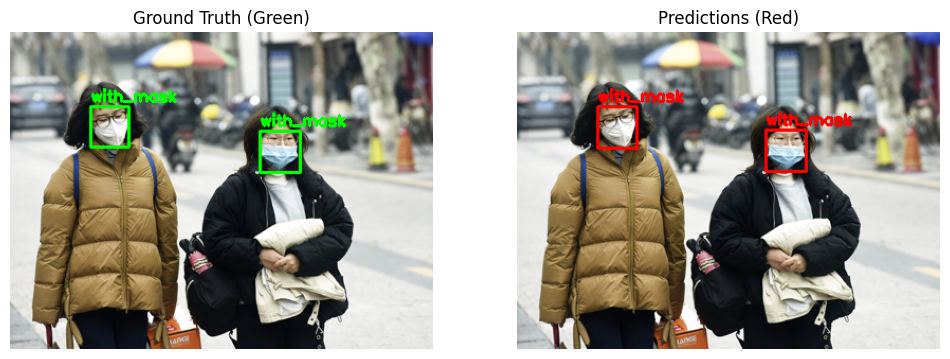


image 1/1 /content/MaskedFace/val/mask-829.png: 320x640 7 with_masks, 3 without_masks, 23.9ms
Speed: 2.4ms preprocess, 23.9ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


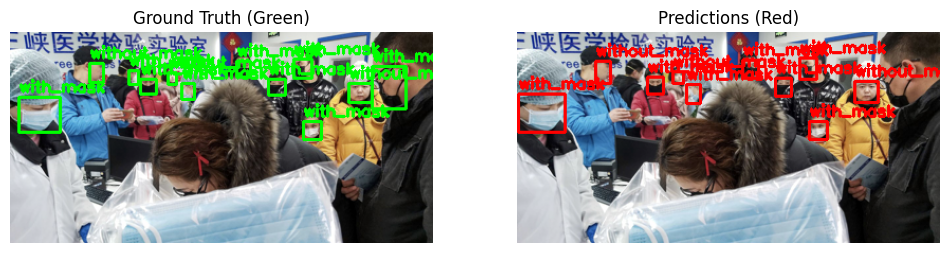


image 1/1 /content/MaskedFace/val/mask-180.png: 640x512 1 with_mask, 29.4ms
Speed: 3.9ms preprocess, 29.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 512)


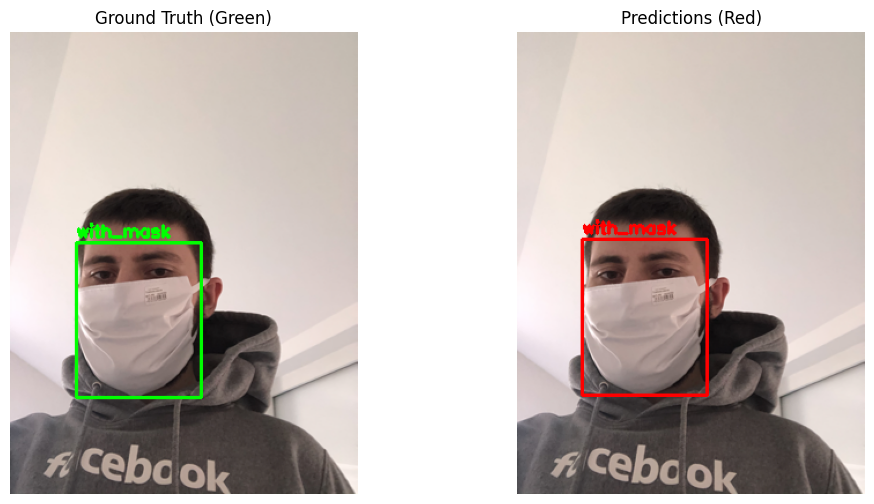


image 1/1 /content/MaskedFace/val/mask-023.png: 480x640 2 with_masks, 29.3ms
Speed: 3.5ms preprocess, 29.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


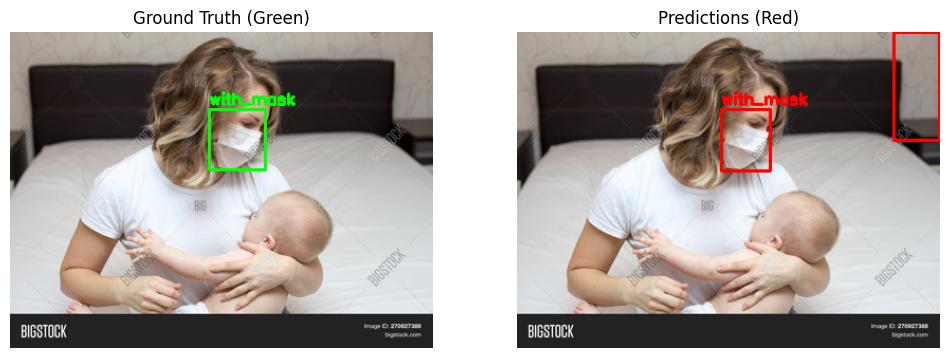


image 1/1 /content/MaskedFace/val/mask-227.png: 448x640 15 with_masks, 28.6ms
Speed: 3.2ms preprocess, 28.6ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


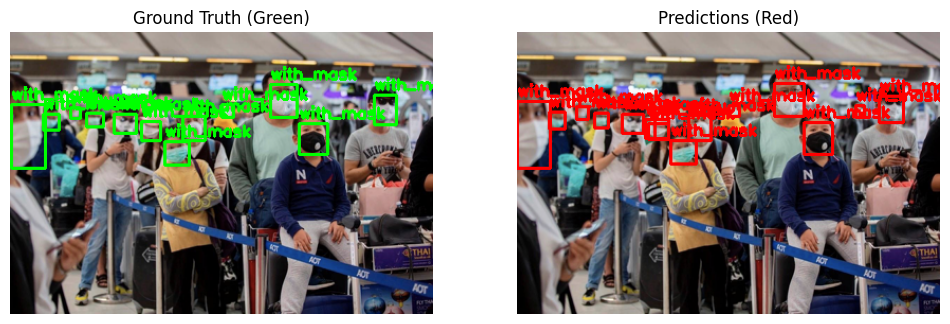


image 1/1 /content/MaskedFace/val/mask-184.png: 352x640 11 with_masks, 26.3ms
Speed: 2.5ms preprocess, 26.3ms inference, 2.2ms postprocess per image at shape (1, 3, 352, 640)


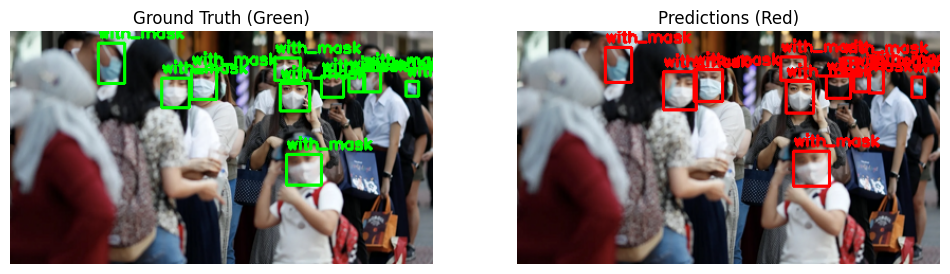


image 1/1 /content/MaskedFace/val/mask-148.png: 608x640 2 with_masks, 3 without_masks, 37.9ms
Speed: 4.1ms preprocess, 37.9ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)


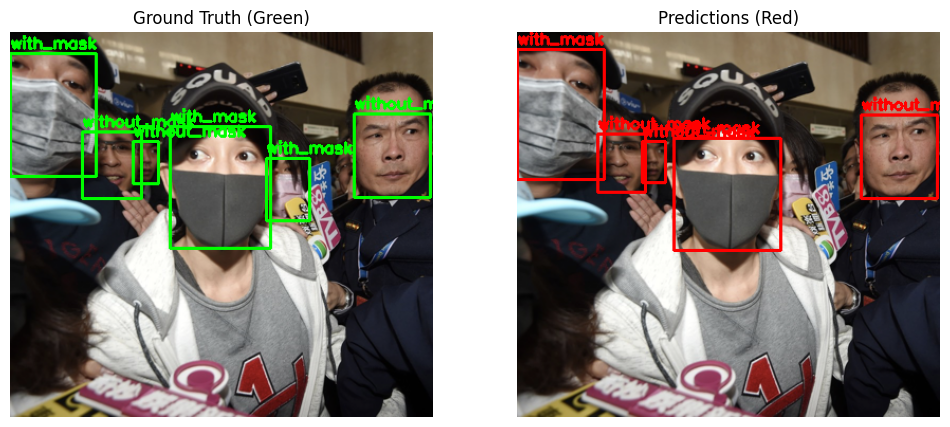


image 1/1 /content/MaskedFace/val/mask-328.png: 640x512 1 with_mask, 29.5ms
Speed: 5.5ms preprocess, 29.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 512)


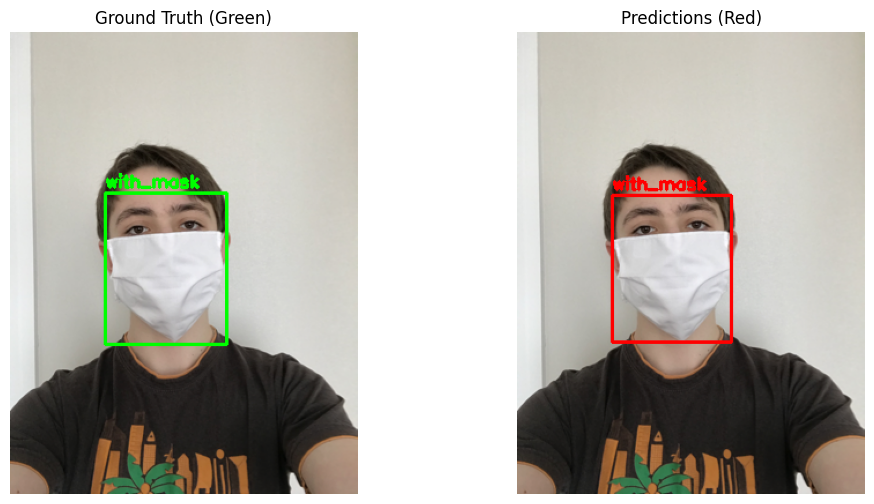


image 1/1 /content/MaskedFace/val/mask-368.png: 448x640 9 with_masks, 28.6ms
Speed: 3.1ms preprocess, 28.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


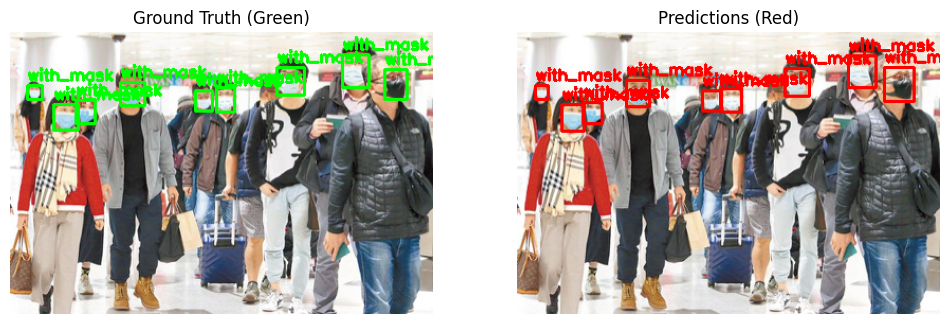


image 1/1 /content/MaskedFace/val/mask-182.png: 448x640 1 with_mask, 1 without_mask, 1 mask_weared_incorrect, 27.4ms
Speed: 7.2ms preprocess, 27.4ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


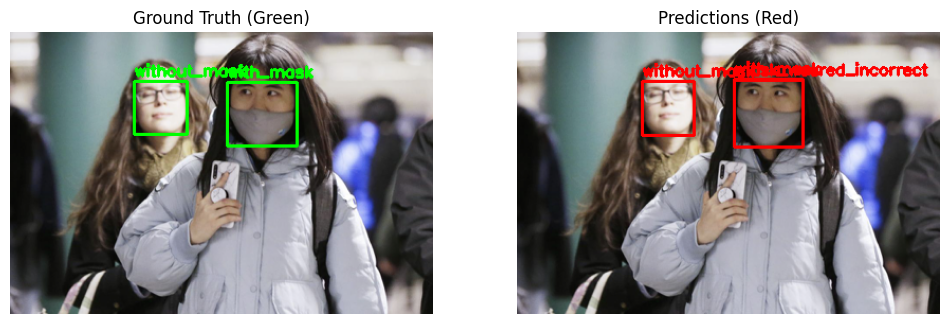


image 1/1 /content/MaskedFace/val/mask-169.png: 640x512 1 with_mask, 29.5ms
Speed: 3.6ms preprocess, 29.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 512)


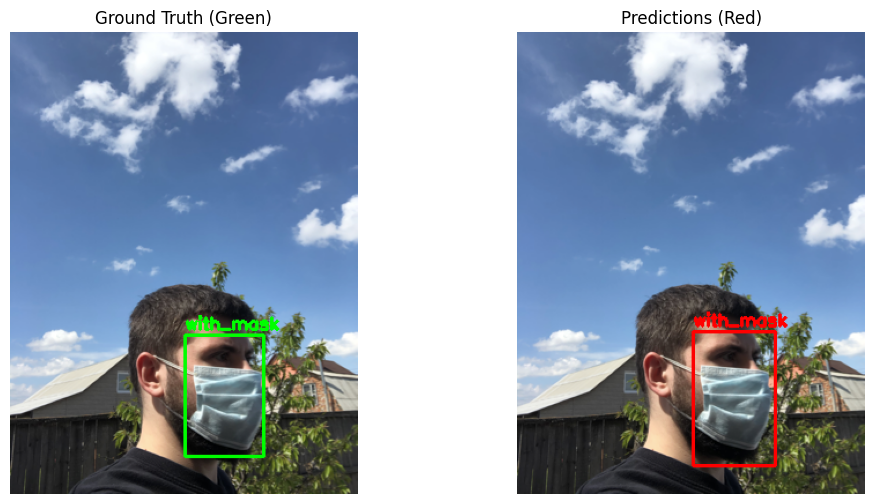


image 1/1 /content/MaskedFace/val/mask-095.png: 640x512 1 without_mask, 28.3ms
Speed: 3.7ms preprocess, 28.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)


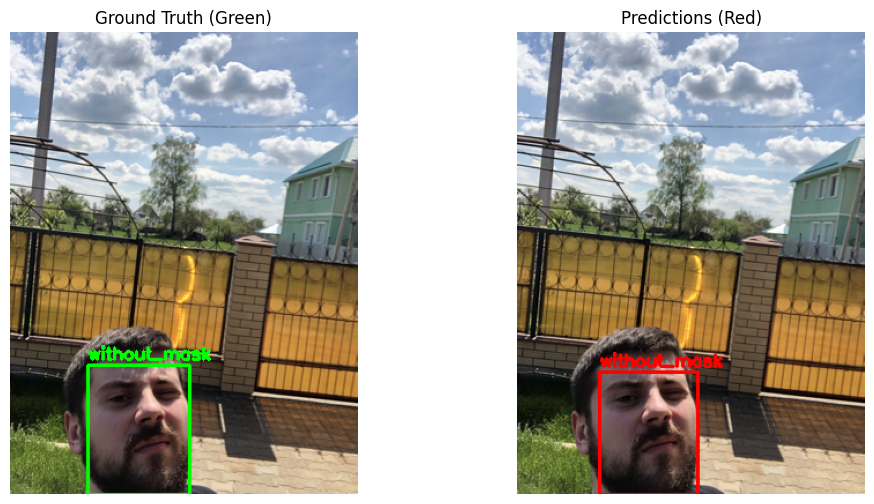


image 1/1 /content/MaskedFace/val/mask-607.png: 448x640 2 with_masks, 28.7ms
Speed: 3.2ms preprocess, 28.7ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


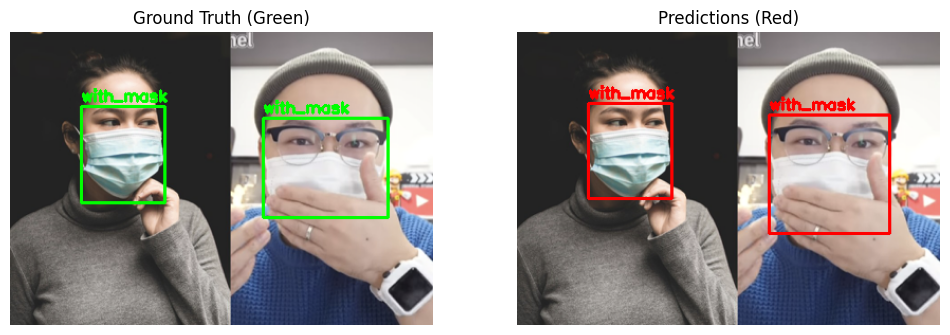


image 1/1 /content/MaskedFace/val/mask-373.png: 448x640 11 with_masks, 2 without_masks, 27.5ms
Speed: 3.2ms preprocess, 27.5ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


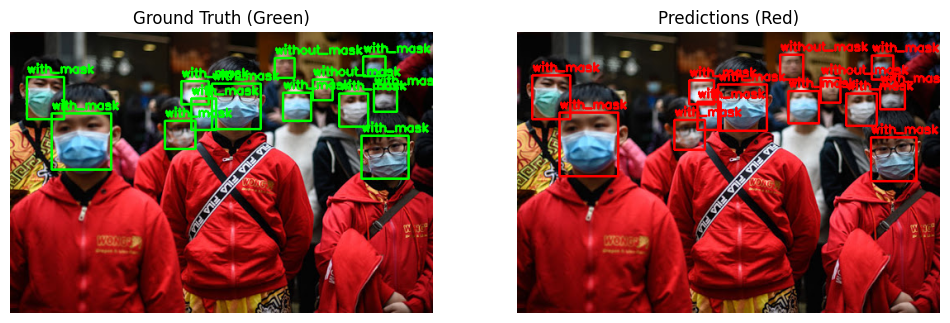


image 1/1 /content/MaskedFace/val/mask-269.png: 480x640 2 with_masks, 29.2ms
Speed: 3.5ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


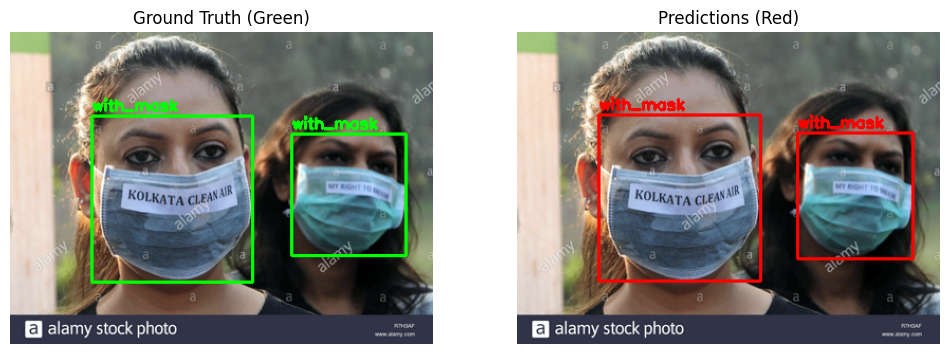


image 1/1 /content/MaskedFace/val/mask-719.png: 384x640 6 with_masks, 1 without_mask, 26.3ms
Speed: 2.7ms preprocess, 26.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


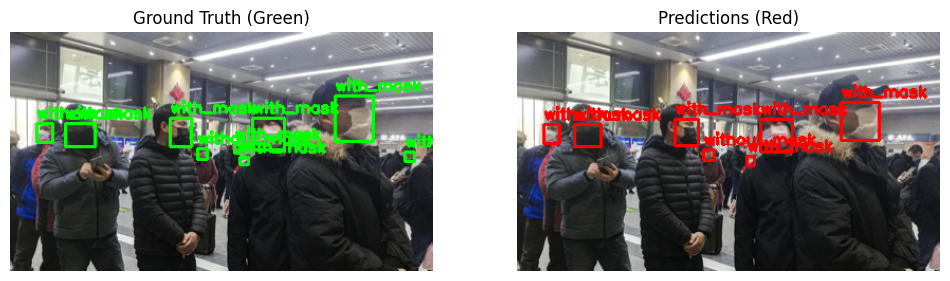


image 1/1 /content/MaskedFace/val/mask-598.png: 640x512 1 with_mask, 29.6ms
Speed: 5.6ms preprocess, 29.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 512)


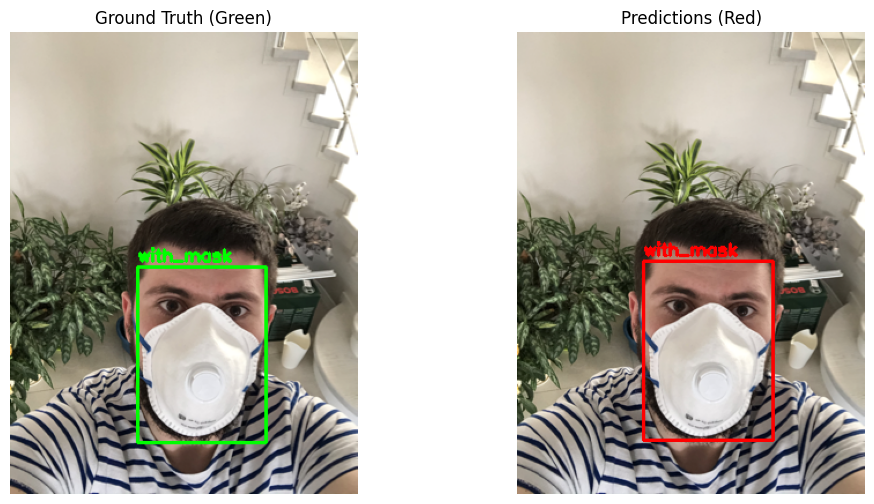


image 1/1 /content/MaskedFace/val/mask-256.png: 448x640 12 with_masks, 28.5ms
Speed: 3.1ms preprocess, 28.5ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


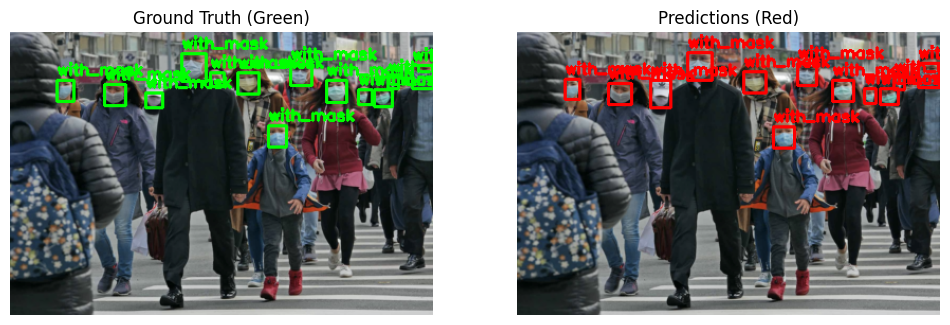


image 1/1 /content/MaskedFace/val/mask-637.png: 384x640 6 with_masks, 29.4ms
Speed: 2.9ms preprocess, 29.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


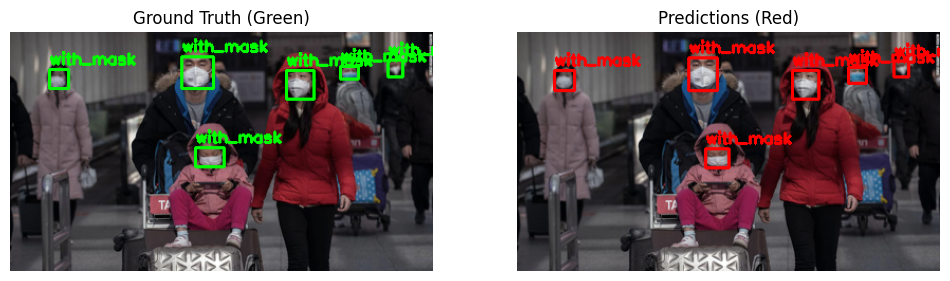


image 1/1 /content/MaskedFace/val/mask-581.png: 640x512 1 with_mask, 42.0ms
Speed: 6.5ms preprocess, 42.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 512)


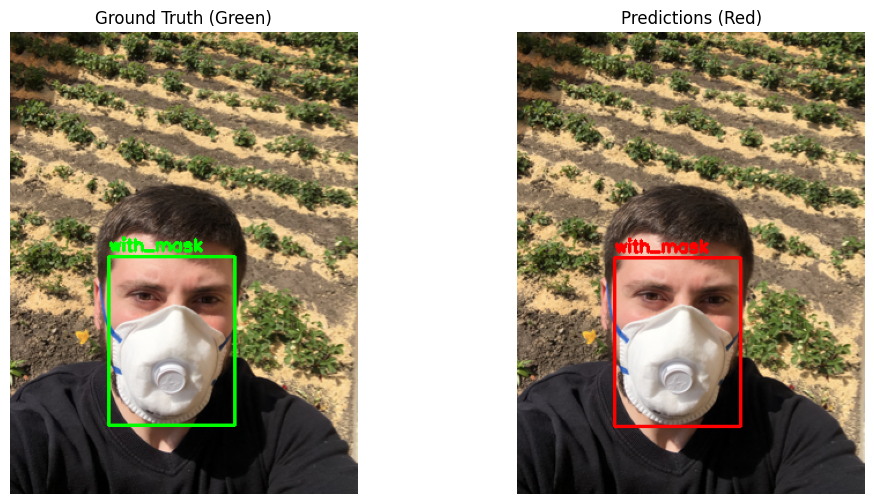


image 1/1 /content/MaskedFace/val/mask-371.png: 384x640 1 mask_weared_incorrect, 26.3ms
Speed: 2.7ms preprocess, 26.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


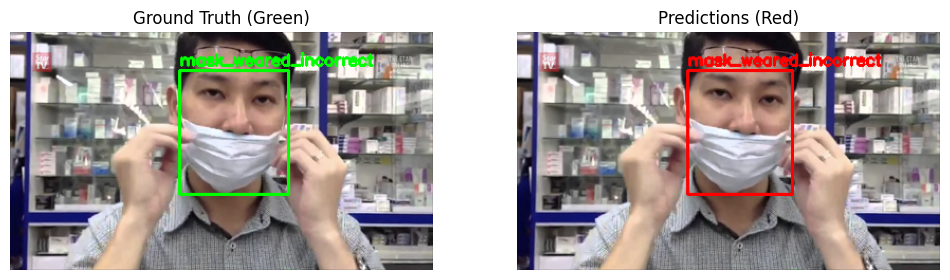


image 1/1 /content/MaskedFace/val/mask-621.png: 384x640 3 with_masks, 1 without_mask, 25.9ms
Speed: 4.2ms preprocess, 25.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


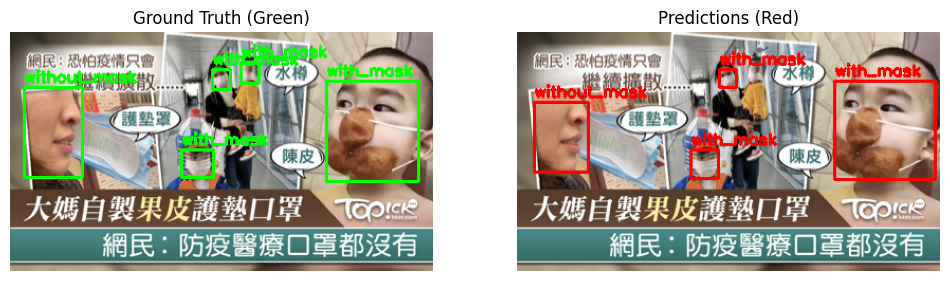


image 1/1 /content/MaskedFace/val/mask-139.png: 384x640 17 with_masks, 1 without_mask, 1 mask_weared_incorrect, 25.2ms
Speed: 7.7ms preprocess, 25.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


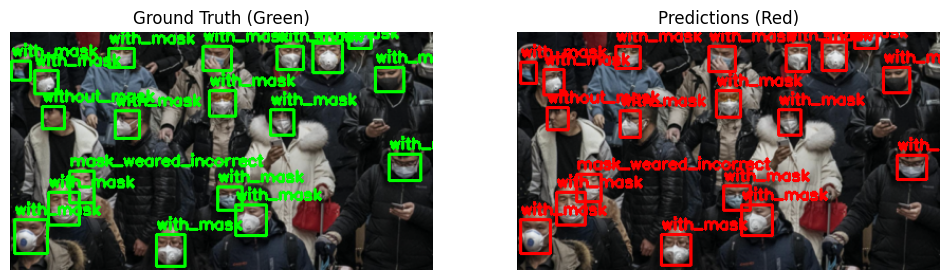


image 1/1 /content/MaskedFace/val/mask-819.png: 384x640 1 with_mask, 1 without_mask, 25.2ms
Speed: 4.6ms preprocess, 25.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


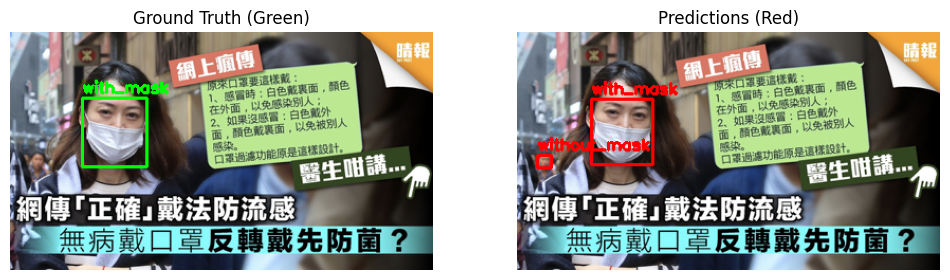


image 1/1 /content/MaskedFace/val/mask-745.png: 640x512 1 with_mask, 29.6ms
Speed: 6.5ms preprocess, 29.6ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 512)


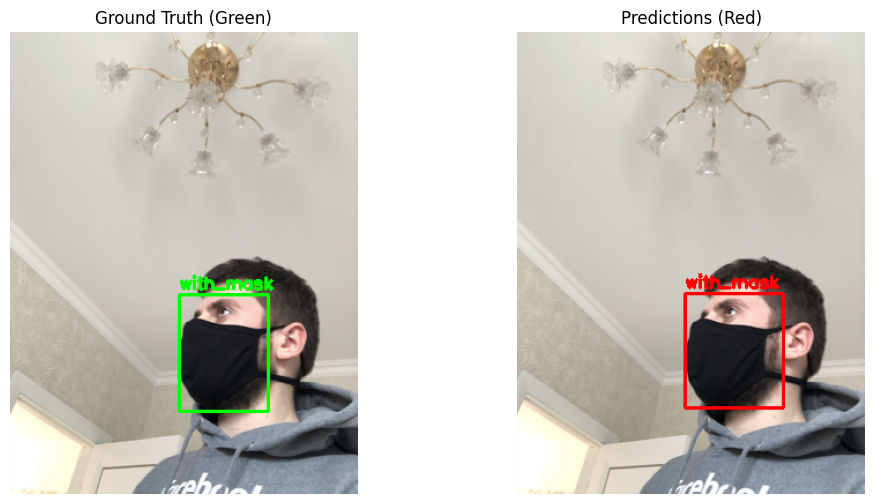


image 1/1 /content/MaskedFace/val/mask-528.png: 640x512 1 without_mask, 28.4ms
Speed: 5.5ms preprocess, 28.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 512)


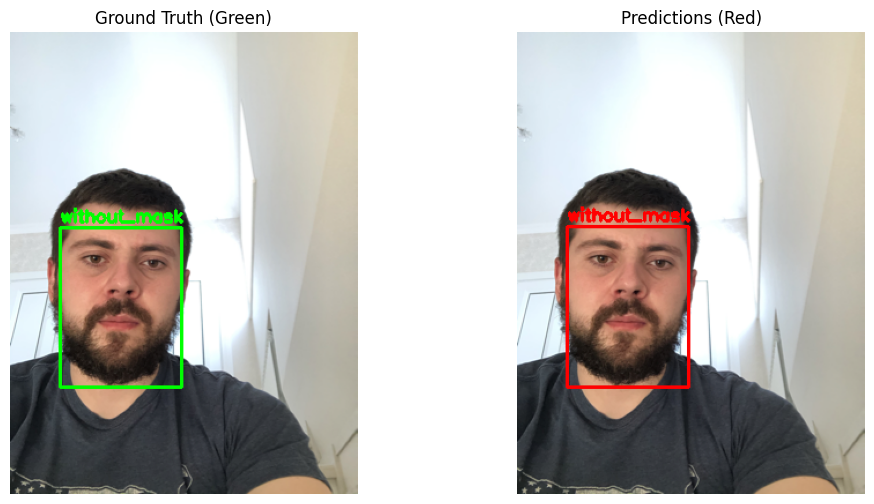


image 1/1 /content/MaskedFace/val/mask-833.png: 384x640 1 with_mask, 50.1ms
Speed: 9.7ms preprocess, 50.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


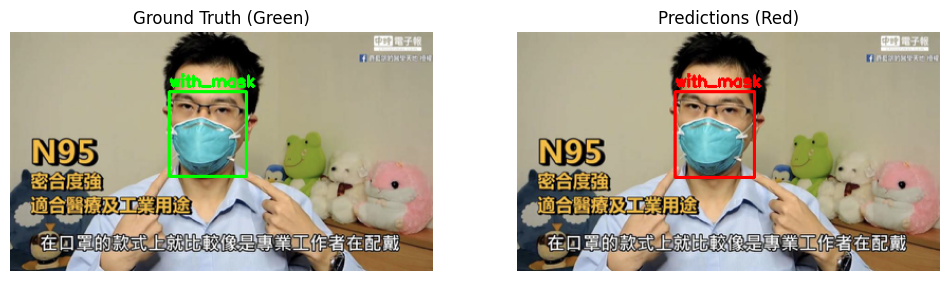


image 1/1 /content/MaskedFace/val/mask-019.png: 384x640 3 with_masks, 3 without_masks, 25.3ms
Speed: 2.9ms preprocess, 25.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


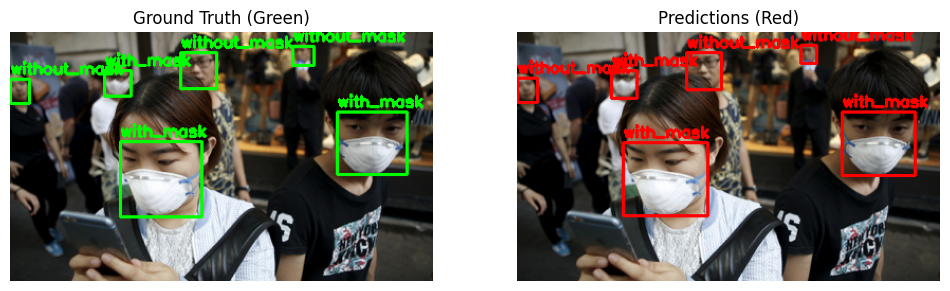


image 1/1 /content/MaskedFace/val/mask-296.png: 384x640 24 with_masks, 20 without_masks, 1 mask_weared_incorrect, 25.2ms
Speed: 2.7ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


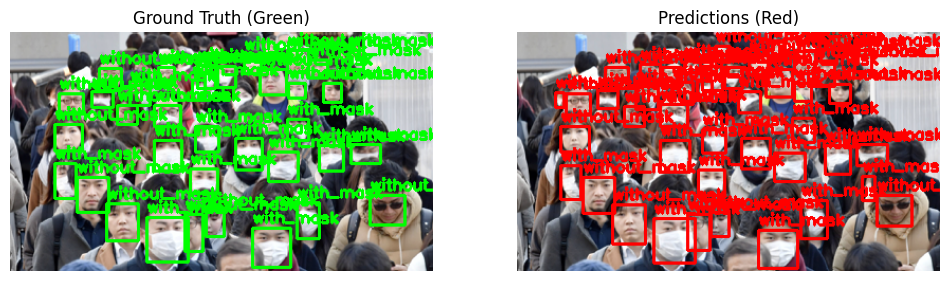


image 1/1 /content/MaskedFace/val/mask-094.png: 384x640 5 with_masks, 1 without_mask, 1 mask_weared_incorrect, 25.2ms
Speed: 2.7ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


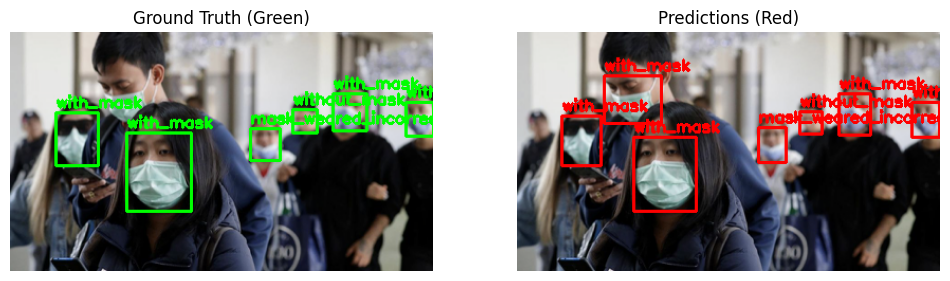


image 1/1 /content/MaskedFace/val/mask-594.png: 448x640 8 with_masks, 28.6ms
Speed: 3.1ms preprocess, 28.6ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


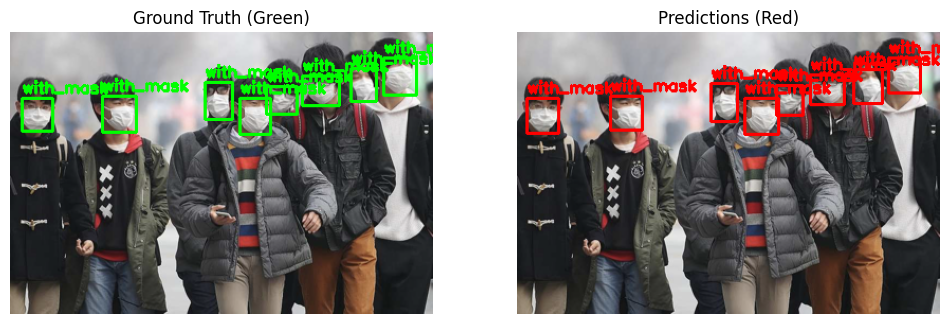


image 1/1 /content/MaskedFace/val/mask-765.png: 640x512 1 with_mask, 29.4ms
Speed: 5.4ms preprocess, 29.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)


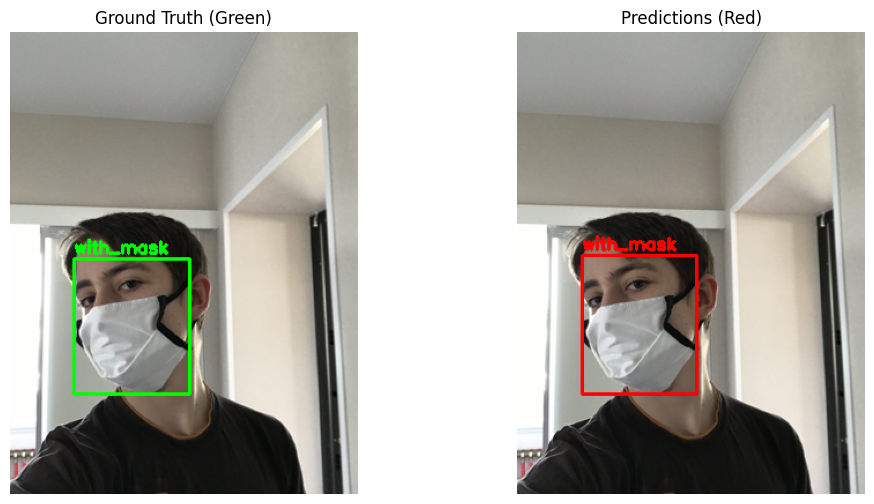


image 1/1 /content/MaskedFace/val/mask-560.png: 448x640 1 with_mask, 28.6ms
Speed: 3.1ms preprocess, 28.6ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


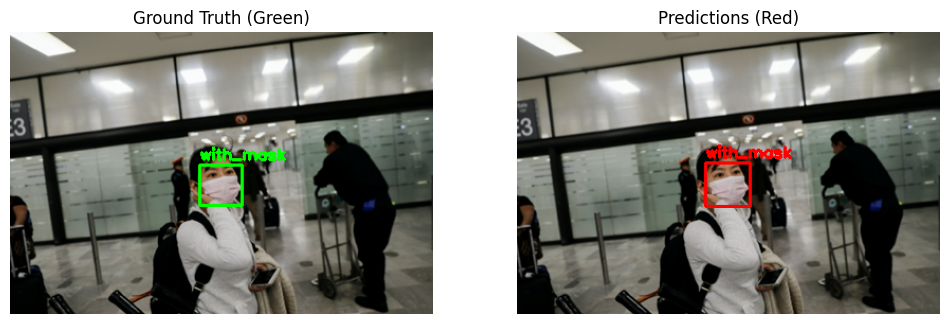


image 1/1 /content/MaskedFace/val/mask-610.png: 352x640 2 with_masks, 26.1ms
Speed: 2.5ms preprocess, 26.1ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)


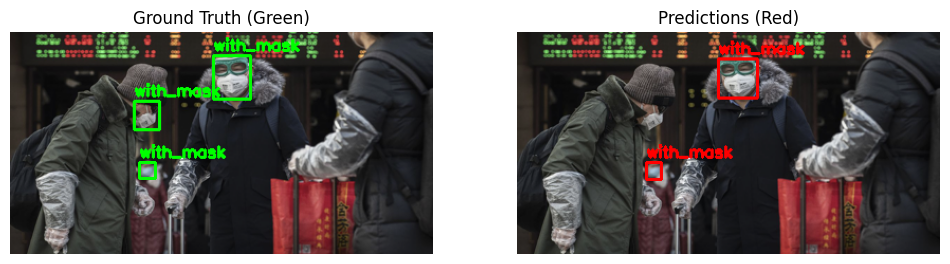


image 1/1 /content/MaskedFace/val/mask-554.png: 480x640 5 with_masks, 29.2ms
Speed: 3.4ms preprocess, 29.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


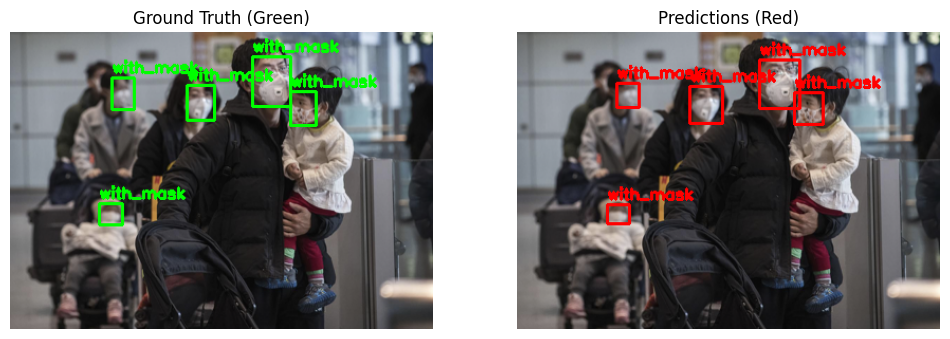


image 1/1 /content/MaskedFace/val/mask-201.png: 384x640 16 with_masks, 26.4ms
Speed: 3.7ms preprocess, 26.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


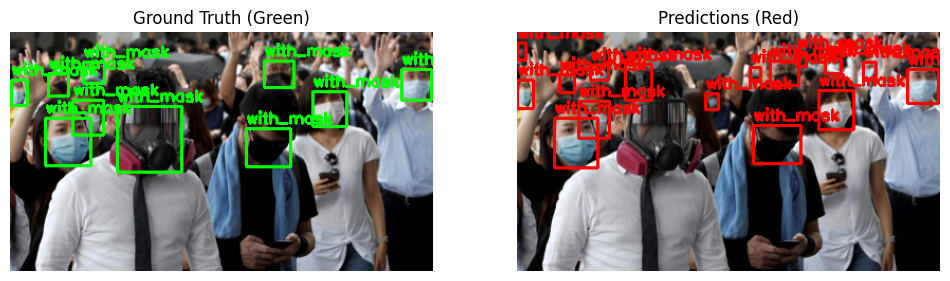


image 1/1 /content/MaskedFace/val/mask-512.png: 448x640 8 with_masks, 28.5ms
Speed: 3.2ms preprocess, 28.5ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


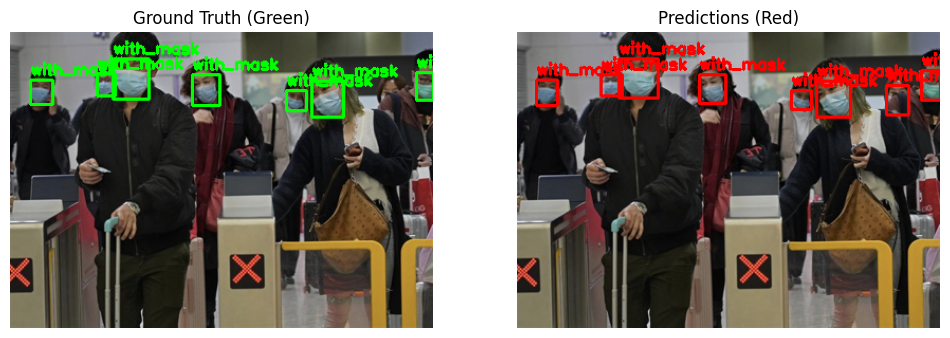


image 1/1 /content/MaskedFace/val/mask-305.png: 480x640 3 with_masks, 9 without_masks, 4 mask_weared_incorrects, 29.1ms
Speed: 3.5ms preprocess, 29.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


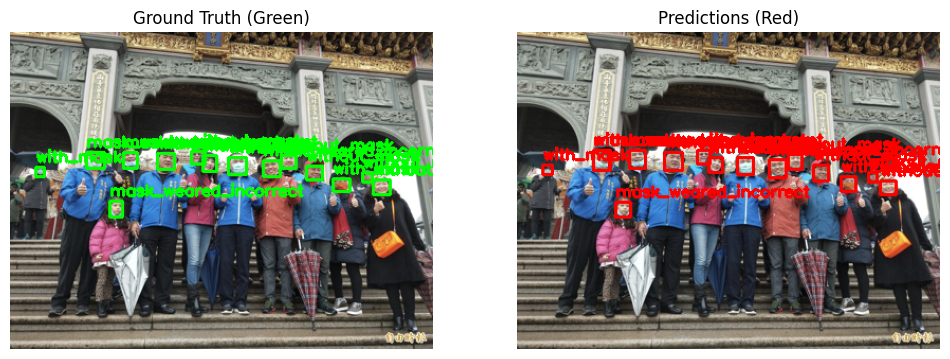


image 1/1 /content/MaskedFace/val/mask-041.png: 480x640 8 with_masks, 1 mask_weared_incorrect, 28.1ms
Speed: 3.4ms preprocess, 28.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


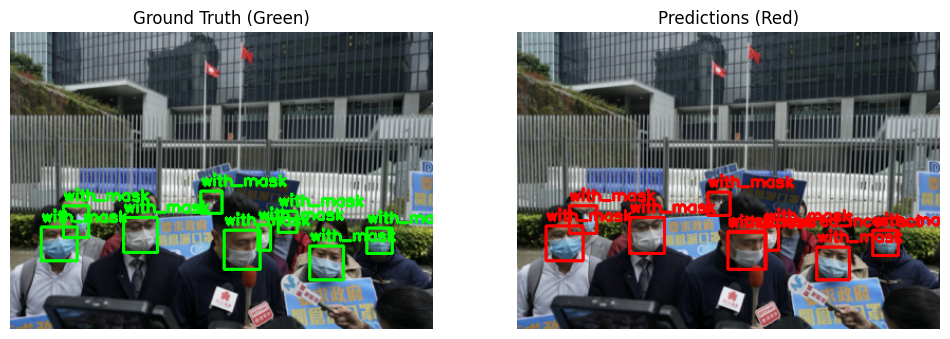


image 1/1 /content/MaskedFace/val/mask-036.png: 384x640 8 with_masks, 26.5ms
Speed: 2.8ms preprocess, 26.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


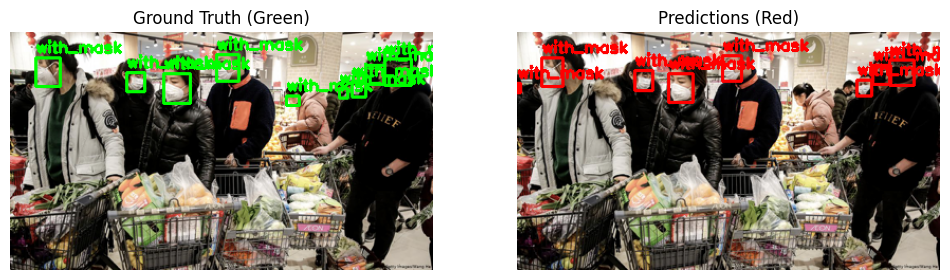

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Load trained YOLOv8 model
model_2 = YOLO("runs/detect/train4/weights/best.pt")  # Update path if needed

# Define dataset paths
image_dir = "/content/MaskedFace/val"
label_dir = "/content/Yolo_directory/labels/val"

# Class names
class_names = ["with_mask", "without_mask", "mask_weared_incorrect"]

# Function to draw bounding boxes
def draw_boxes(image, boxes, labels, color=(0, 255, 0)):
    for i, box in enumerate(boxes):
        x_center, y_center, w, h = box
        x1, y1 = int((x_center - w / 2) * image.shape[1]), int((y_center - h / 2) * image.shape[0])
        x2, y2 = int((x_center + w / 2) * image.shape[1]), int((y_center + h / 2) * image.shape[0])
        label = class_names[labels[i]]
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, label, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return image

# Iterate over validation images
for image_file in os.listdir(image_dir):
    if not image_file.endswith((".jpg", ".png")):
        continue  # Skip non-image files

    image_path = os.path.join(image_dir, image_file)
    label_path = os.path.join(label_dir, image_file.replace(".jpg", ".txt").replace(".png", ".txt"))

    # Load ground truth labels
    actual_boxes, actual_labels = [], []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                values = line.split()
                class_idx = int(values[0])  # Class label
                box = list(map(float, values[1:]))  # Bounding box
                actual_labels.append(class_idx)
                actual_boxes.append(box)

    # Run inference
    results = model_2(image_path)

    # Extract detected bounding boxes and labels
    detected_boxes, detected_labels = [], []
    for r in results:
        for box in r.boxes:
            detected_boxes.append(box.xywhn.cpu().numpy()[0])  # Normalize to match YOLO format
            detected_labels.append(int(box.cls.item()))

    # Load image
    original_image = cv2.imread(image_path)
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

    # Draw ground truth and predictions
    image_gt = draw_boxes(original_image.copy(), actual_boxes, actual_labels, color=(0, 255, 0))  # Green for GT
    image_pred = draw_boxes(original_image.copy(), detected_boxes, detected_labels, color=(255, 0, 0))  # Red for Predictions

    # Show side-by-side comparison
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(image_gt)
    ax[0].set_title("Ground Truth (Green)")
    ax[0].axis("off")

    ax[1].imshow(image_pred)
    ax[1].set_title("Predictions (Red)")
    ax[1].axis("off")

    plt.show()

    # Optionally, save images
    cv2.imwrite(f"results/gt_{image_file}", cv2.cvtColor(image_gt, cv2.COLOR_RGB2BGR))
    cv2.imwrite(f"results/pred_{image_file}", cv2.cvtColor(image_pred, cv2.COLOR_RGB2BGR))
